In [1]:
%load_ext autoreload
%autoreload 2
import infercnvpy as cnv
import scanpy as sc
from scanpy_helpers.annotation import AnnotationHelper

INFO:numexpr.utils:Note: NumExpr detected 64 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
INFO:get_version:dirname: Trying to get version of get_version from dirname /home/sturm/.conda/envs/pircher-sc-infercnv/lib/python3.8/site-packages
INFO:get_version:dirname: Failed; Does not match re.compile('get[_-]version-([\\d.]+?)(?:\\.dev(\\d+))?(?:[_+-]([0-9a-zA-Z.]+))?$')
INFO:get_version:git: Trying to get version from git in directory /home/sturm/.conda/envs/pircher-sc-infercnv/lib/python3.8/site-packages
INFO:get_version:git: Failed; directory is not managed by git
INFO:get_version:metadata: Trying to get version for get_version in dir /home/sturm/.conda/envs/pircher-sc-infercnv/lib/python3.8/site-packages
INFO:get_version:metadata: Succeeded
INFO:get_version:dirname: Trying to get version of legacy_api_wrap from dirname /home/sturm/.conda/envs/pircher-sc-infercnv/lib/python3.8/site-packages
INFO:get_version:dirname: Failed; Does not match re.compile('legacy[_-]

In [2]:
ah = AnnotationHelper()

In [3]:
sc.set_figure_params(figsize=(5, 5))

In [4]:
adata = sc.read_h5ad(
    "../../data/50_integrate_scrnaseq_data/integrated_merged_all.h5ad"
)

In [5]:
adata_infercnv = sc.AnnData(
    X=adata.raw.X,
    var=adata.raw.var,
    obs=adata.obs,
    obsm=adata.obsm,
    uns=adata.uns,
    obsp=adata.obsp,
)

In [6]:
cnv.io.genomic_position_from_gtf(
    "/data/genomes/hg38/annotation/gencode/gencode.v33.primary_assembly.annotation.gtf",
    adata_infercnv,
)

INFO:root:Extracted GTF attributes: ['gene_id', 'gene_name']


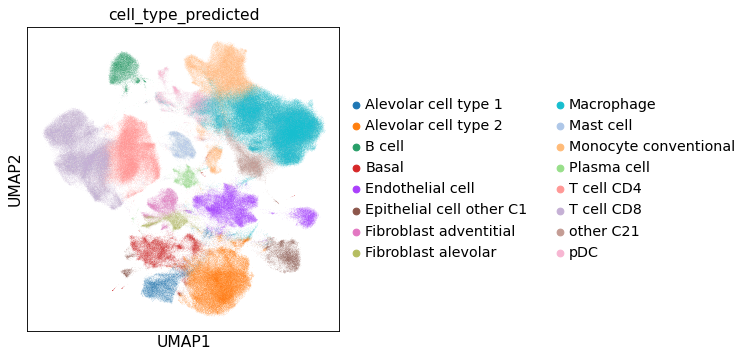

In [7]:
sc.pl.umap(adata, color="cell_type_predicted")

In [8]:
%%time
cnv.tl.infercnv(
    adata_infercnv,
    reference_key="cell_type_predicted",
    reference_cat=[
        "T cell CD4",
        "T cell CD8",
        "Monocyte conventional",
        "Macrophage",
        "Mast cell",
        "Plasma cell",
        "B cell",
        "pDC",
    ],
    window_size=250,
)

/home/sturm/.conda/envs/pircher-sc-infercnv/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
100%|██████████| 111/111 [01:14<00:00,  1.48it/s]


CPU times: user 1min 38s, sys: 1min 2s, total: 2min 40s
Wall time: 3min 23s


In [9]:
adata = adata_infercnv

In [10]:
cnv.tl.pca(adata)
cnv.pp.neighbors(adata)
cnv.tl.umap(adata)

In [11]:
cnv.tl.leiden(adata, resolution=1.5)

In [12]:
cnv.tl.cnv_score(adata)

... storing 'chromosome' as categorical
... storing 'gene_id' as categorical
... storing 'gene_name' as categorical


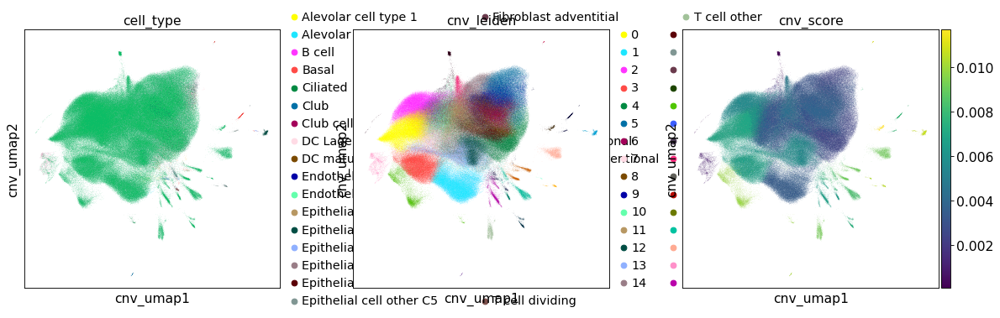

In [13]:
cnv.pl.umap(adata, color=["cell_type", "cnv_leiden", "cnv_score"])

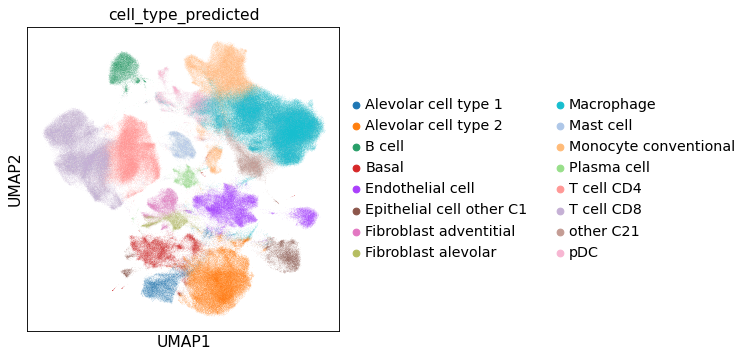

In [14]:
sc.pl.umap(adata, color="cell_type_predicted")

In [15]:
sc.tl.leiden(adata)

In [16]:
# adata = sc.read_h5ad("./tmp_adata.h5ad")

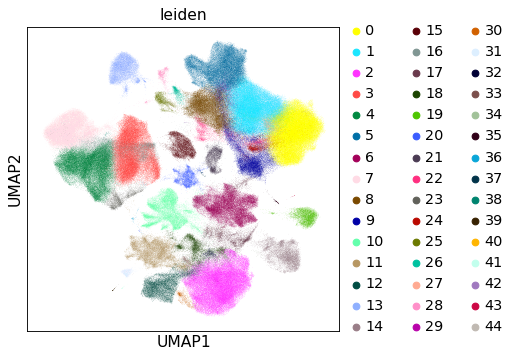

In [17]:
sc.pl.umap(adata, color="leiden")

Alevolar cell type 1


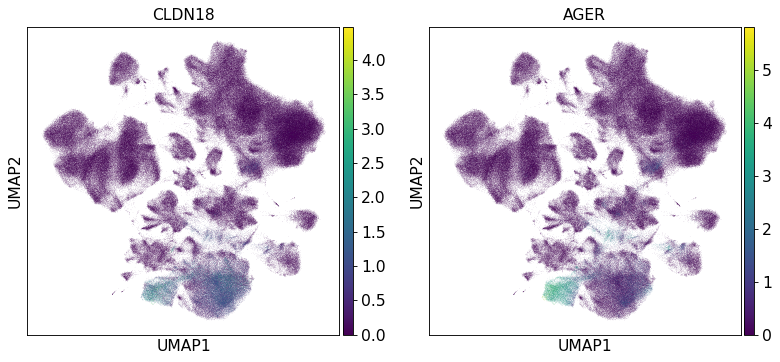

Alevolar cell type 2


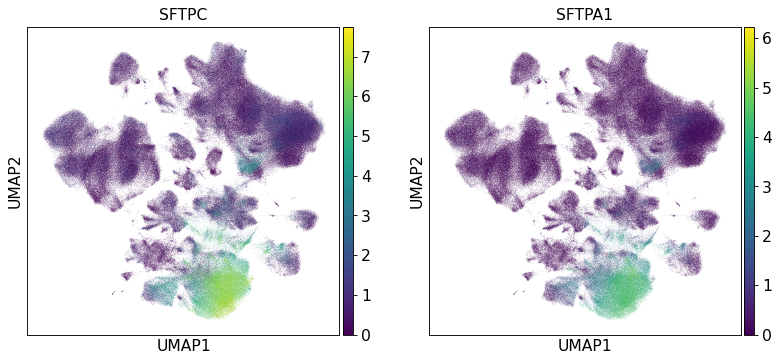

Alevolar cells (type 1 and 2)


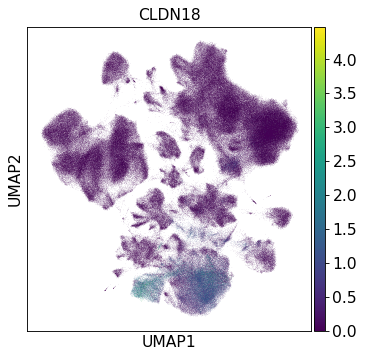

B cell


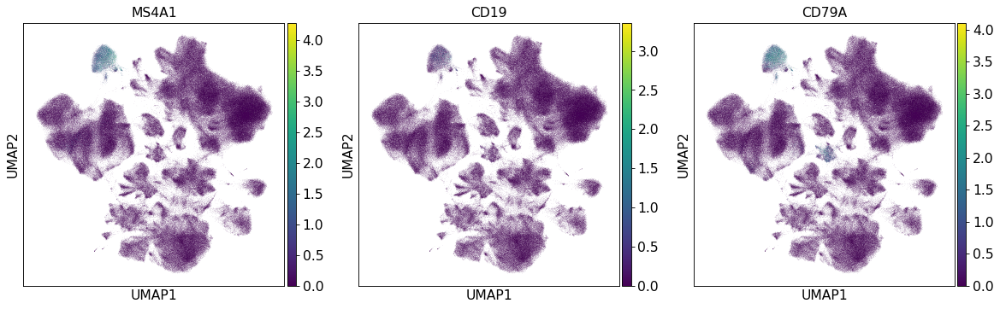

Basal


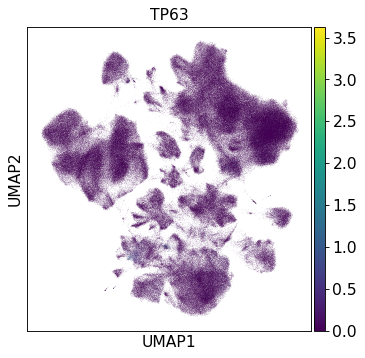

Ciliated


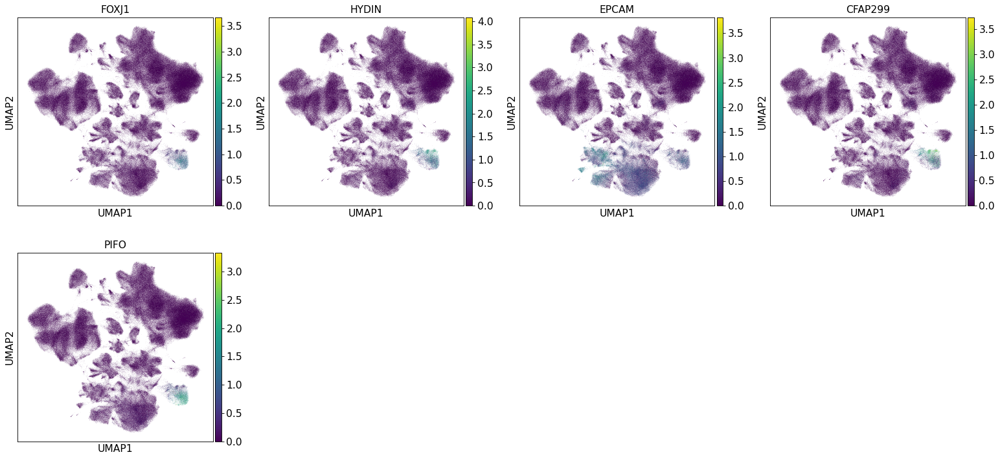

Club


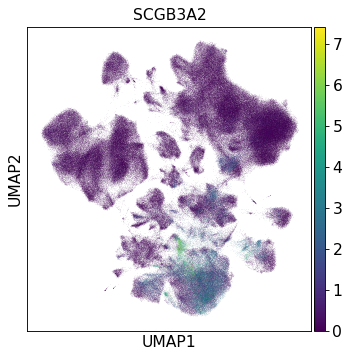

DC Lagerhans


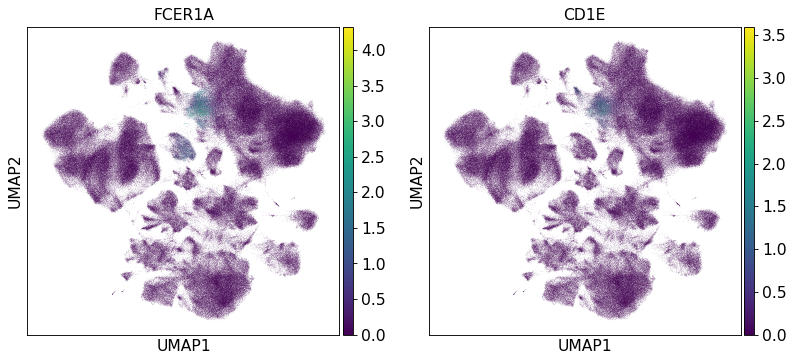

DC mature


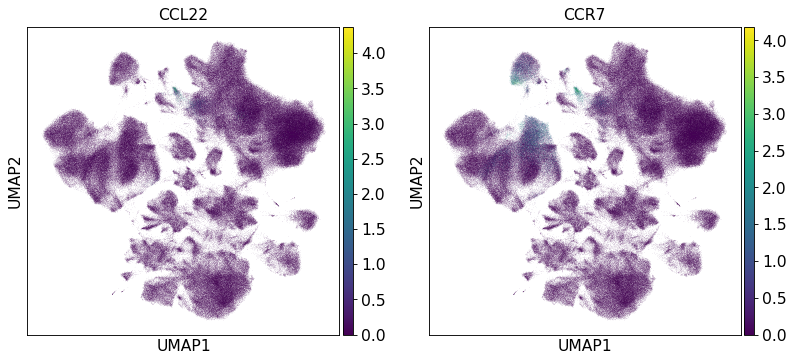

Dividing


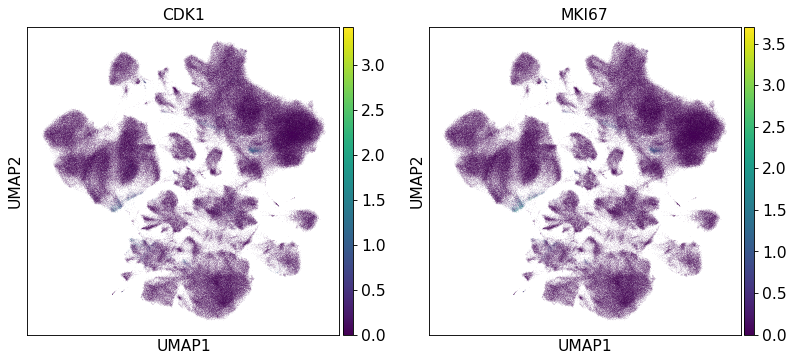

Endothelial cell


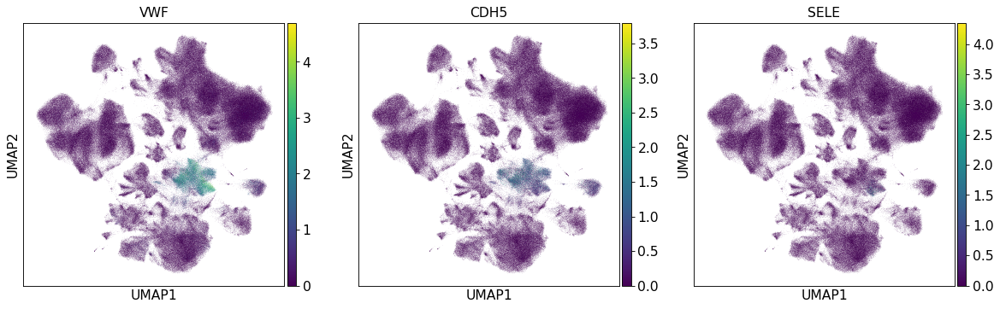

Endothelial cell lymphatic


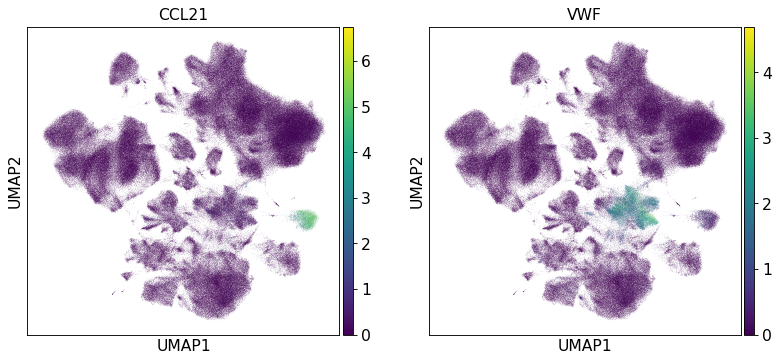

Epithelial


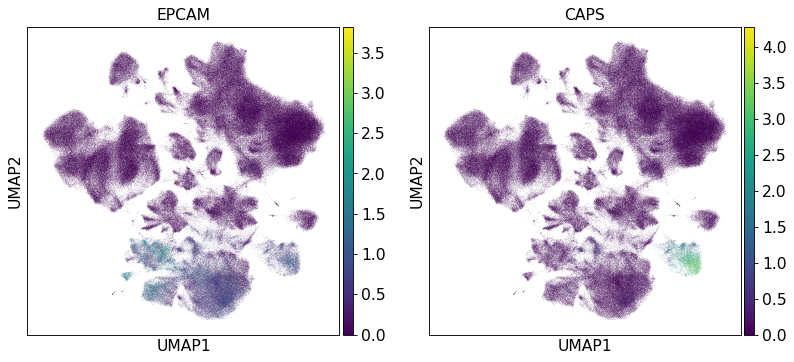

Fibroblast


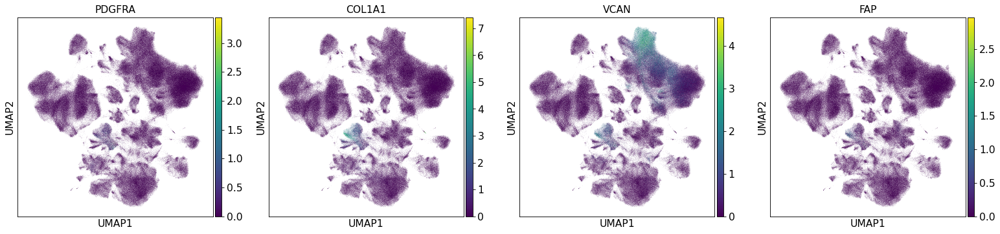

Fibroblast adventitial


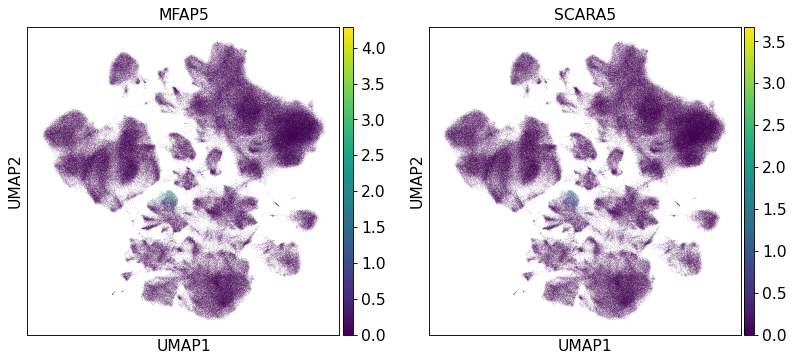

Fibroblast alveolar


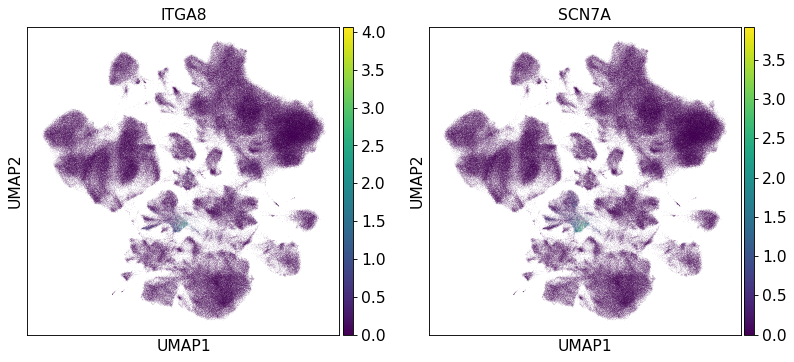

Goblet


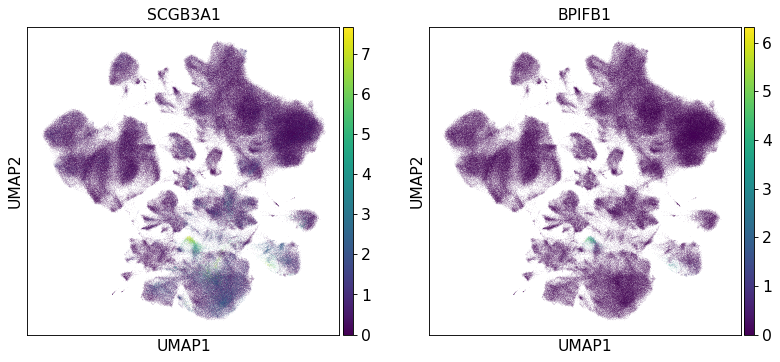

Ionocyte


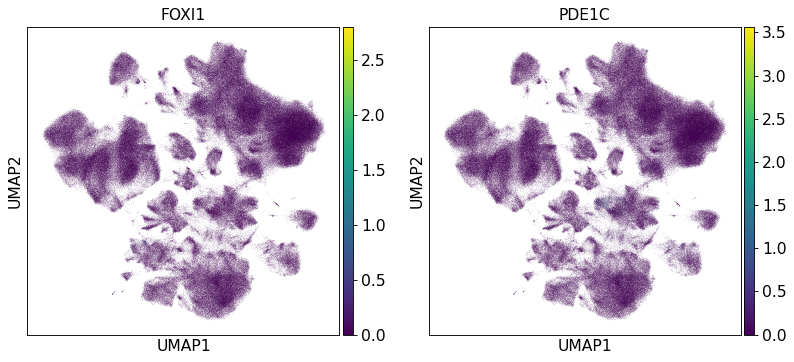

Macrophage


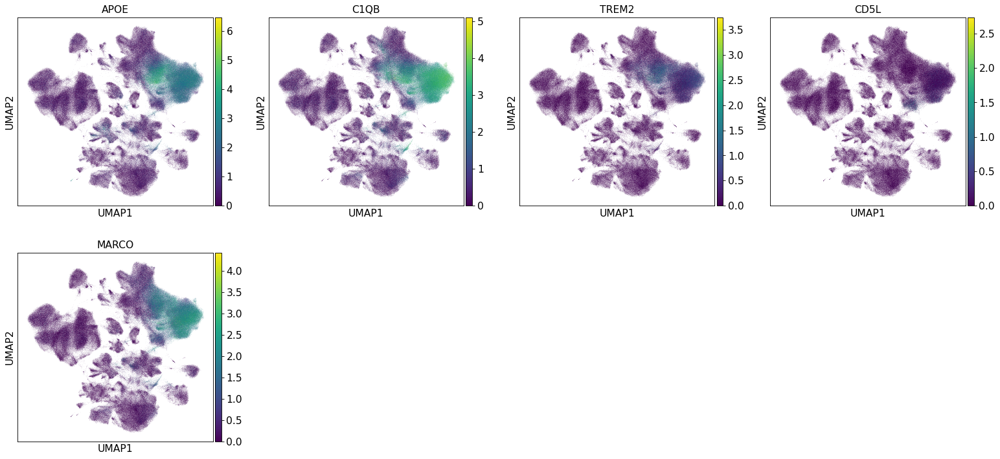

Macrophage alveolar


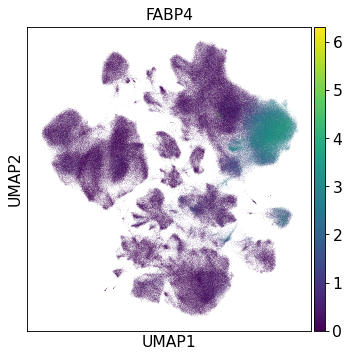

Mast cells


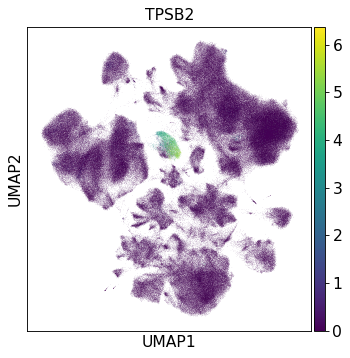

Mesothelial


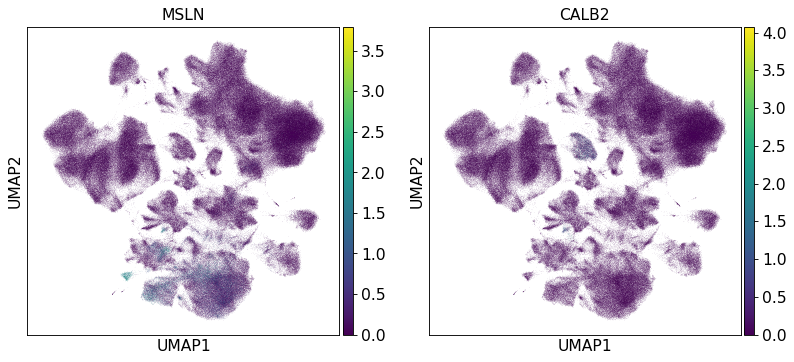

Monocyte


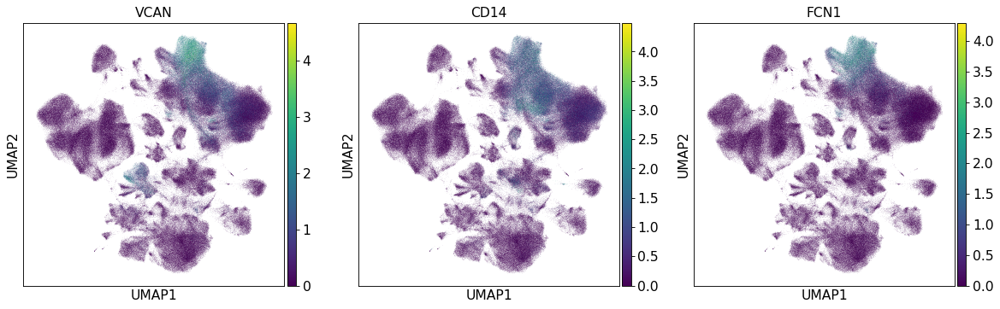

Monocyte conventional


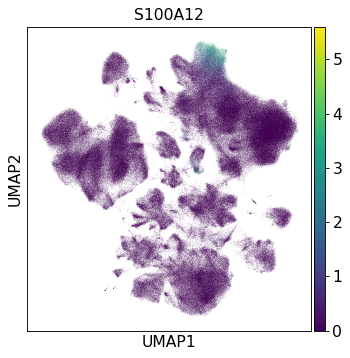

Monocyte non-coventional


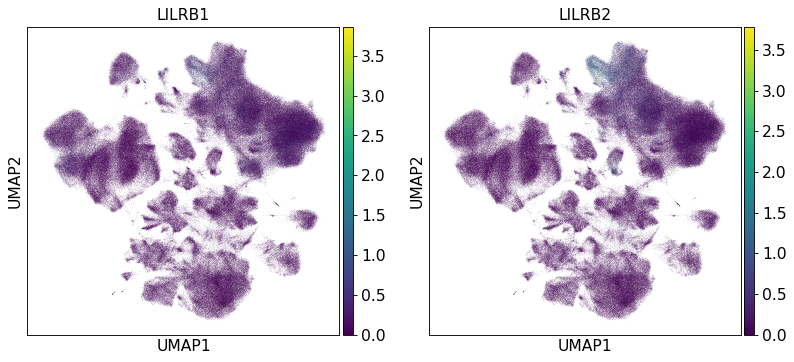

NK cell


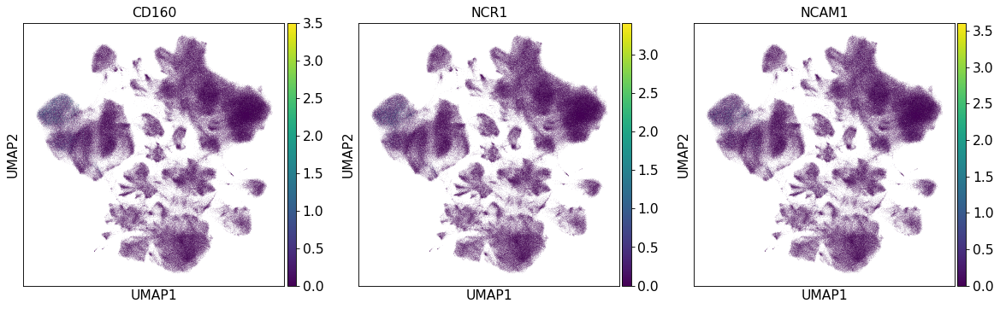

Pericyte


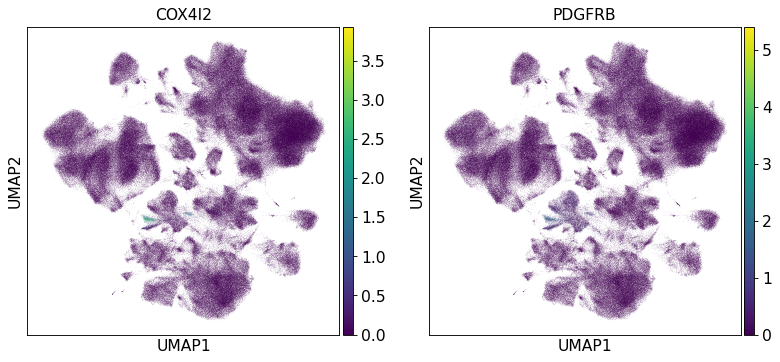

Plasma cell


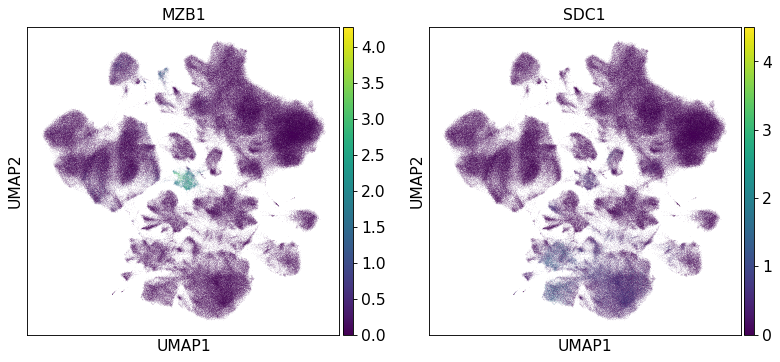

Pulmonary neuroendocrine cell


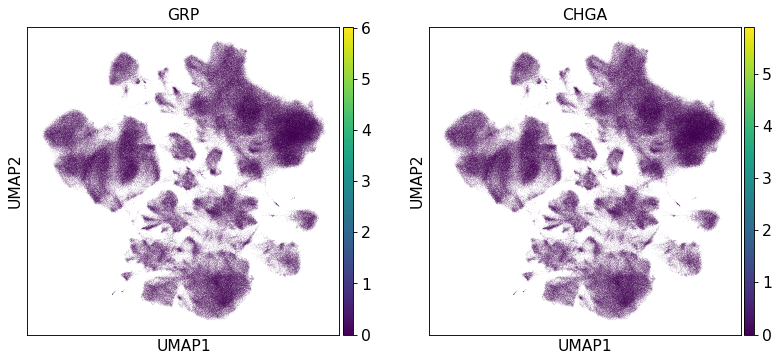

Smooth muscle cell


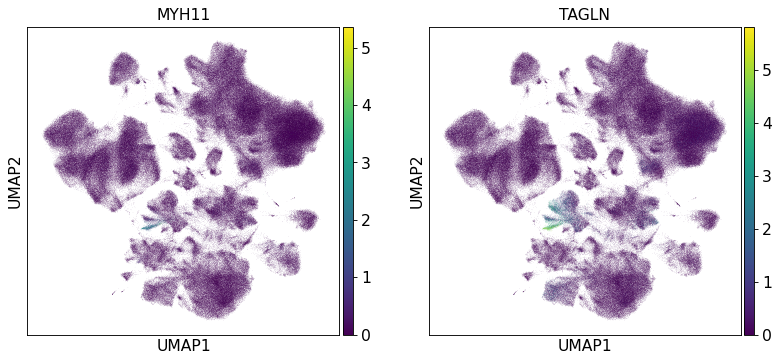

Suprabasal


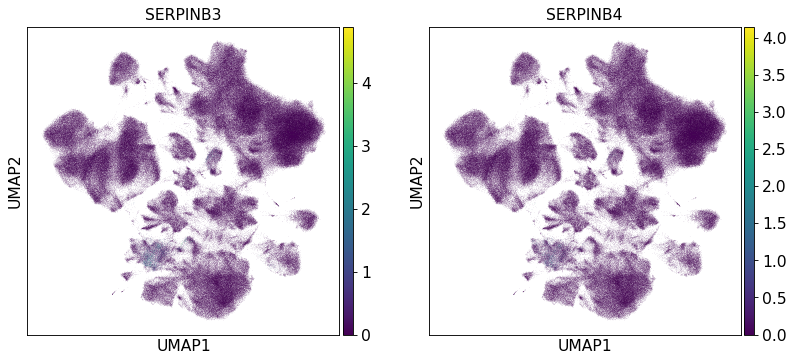

T cell


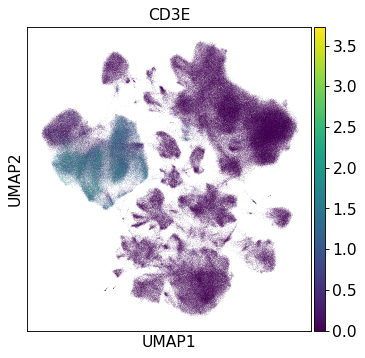

T cell CD4


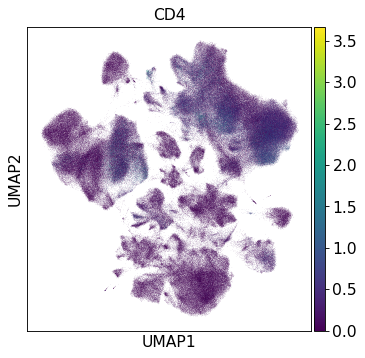

T cell CD8


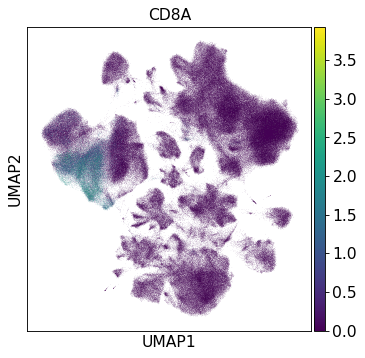

T cell cytotoxic


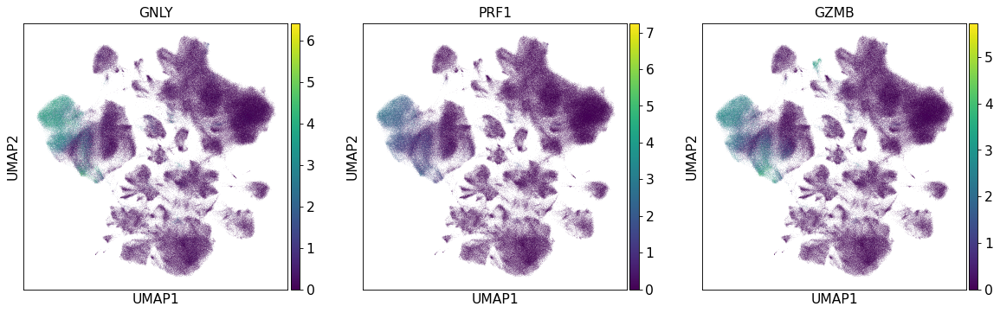

T cell regulatory


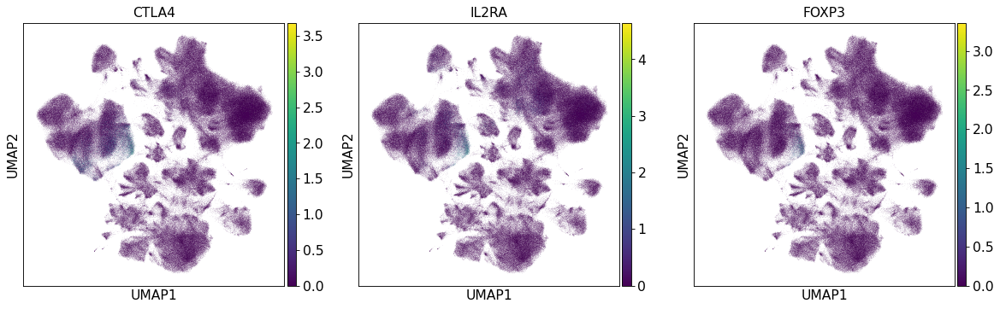

Vessel


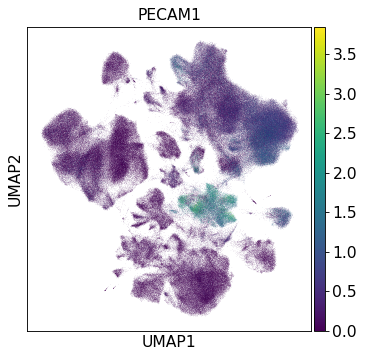

cDC1


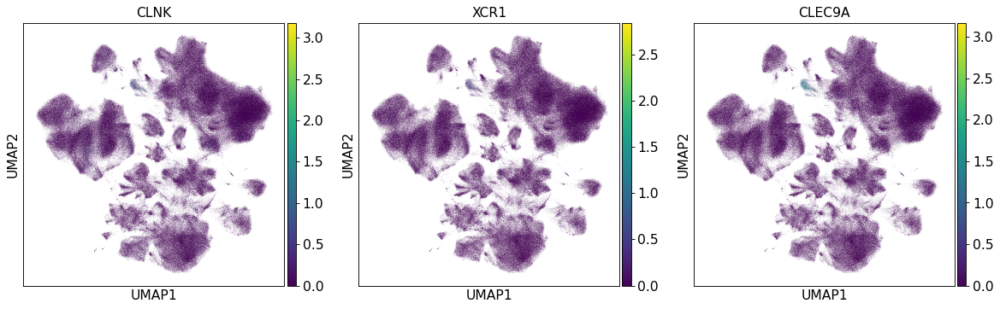

cDC2


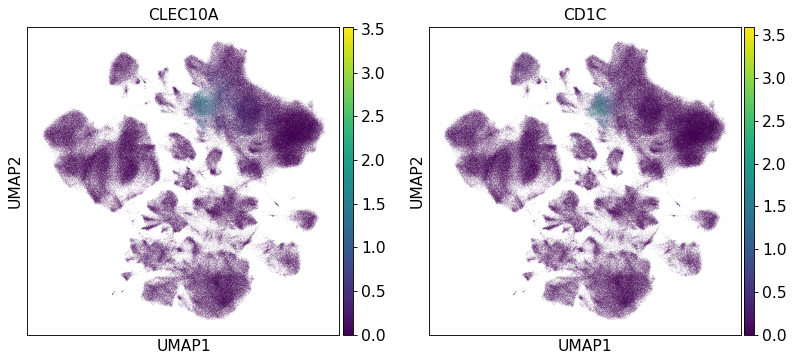

pDC


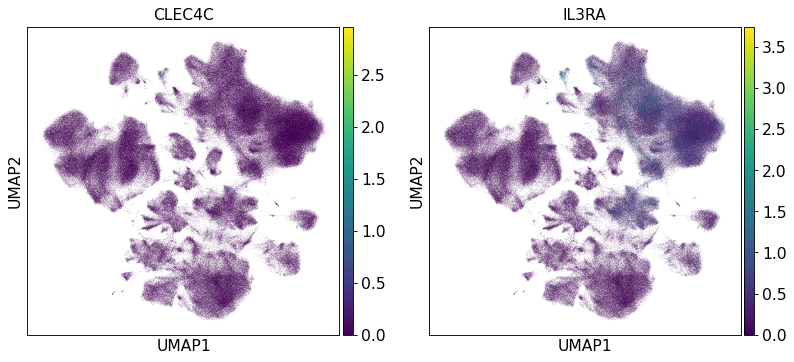

In [18]:
ah.plot_umap(adata)

Marker MIR205HG for Basal not in adata.var


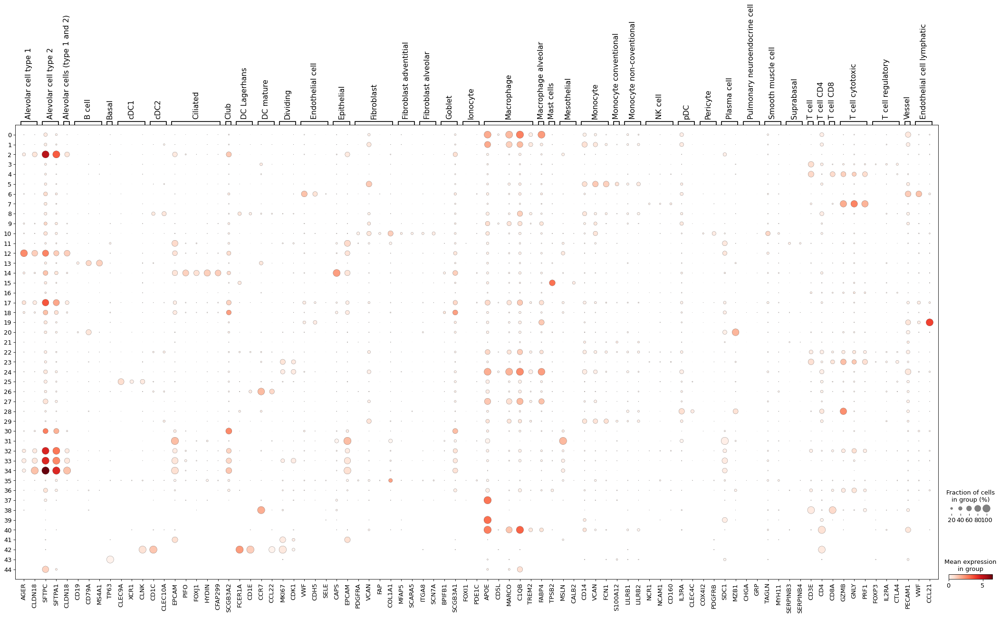

In [19]:
ah.plot_dotplot(adata)

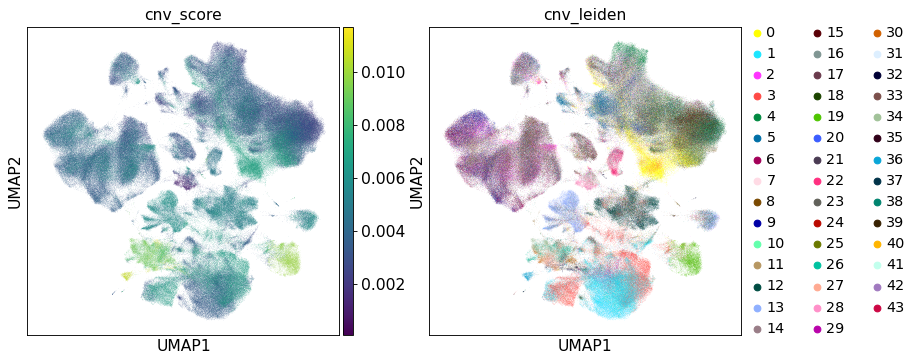

In [20]:
sc.pl.umap(adata, color=["cnv_score", "cnv_leiden"])

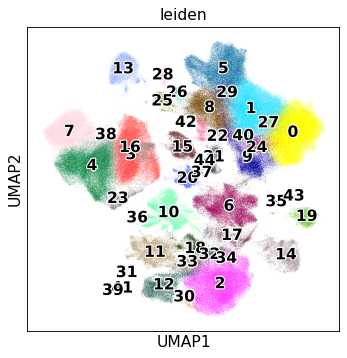

In [21]:
sc.pl.umap(adata, color="leiden", legend_loc="on data", legend_fontoutline=2)

In [22]:
ct_map = {
    "B cell": [13],
    "Ciliated (malignant)": [14],
    "Endothelial cell": [6],
    "Endothelial cell lymphatic": [19],
    "Epithelial cell": [12, 30, 2, 34, 33, 11, 18, 32, 17, 31],
    "Mast cell": [],
    "Myeloid": [25, 26, 5, 92, 8, 1, 27, 40, 24, 0, 9, 22, 21, 41, 37],
    "NK cell": [7],
    "Stromal": [10, 35],
    "Plasma cell": [20],
    "T cell": [4, 23, 3, 16, 38],
    "pDC": [28],
}

... storing 'cell_type' as categorical


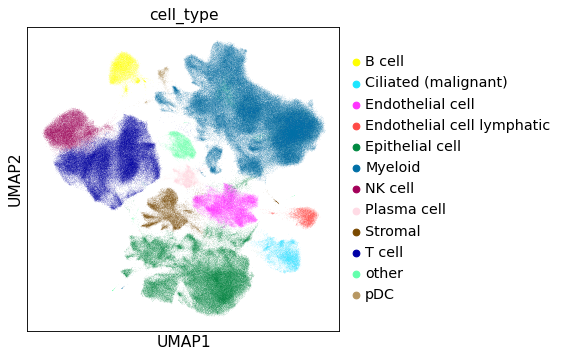

In [23]:
ah.annotate_cell_types(adata, ct_map)

In [24]:
adata_t = adata[adata.obs["cell_type"] == "T cell", :].copy()
ah.reprocess_adata_subset_scvi(adata_t, use_rep="X_scANVI", leiden_res=1.5)

/home/sturm/.conda/envs/pircher-sc-infercnv/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Alevolar cell type 1


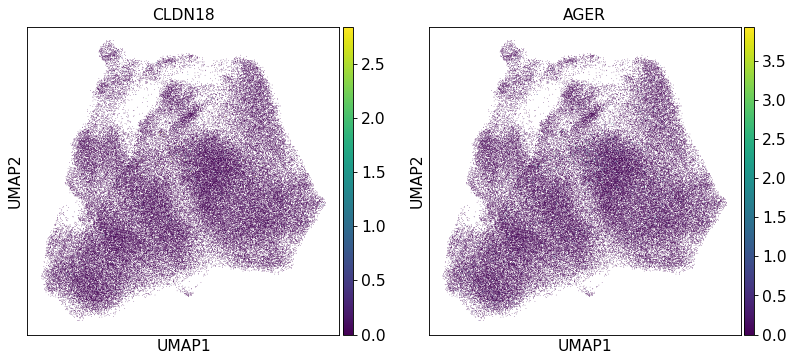

Alevolar cell type 2


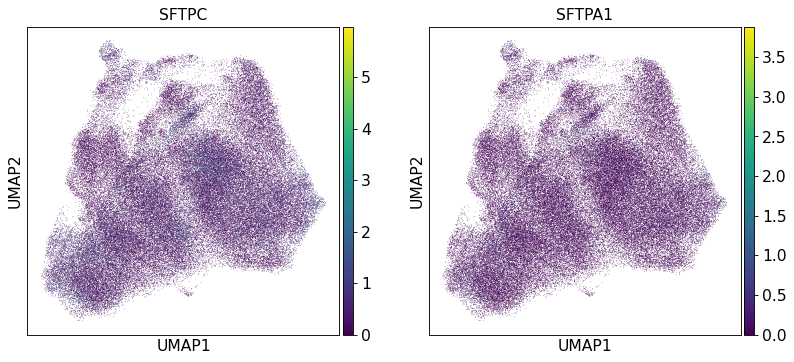

Alevolar cells (type 1 and 2)


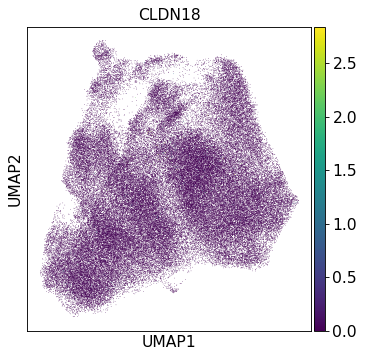

B cell


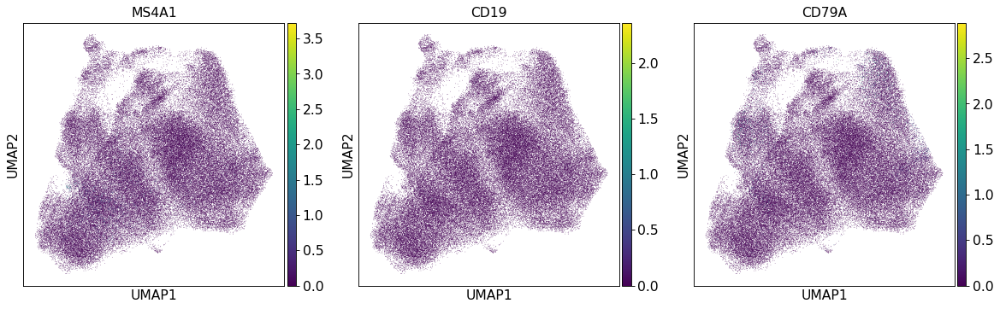

Basal


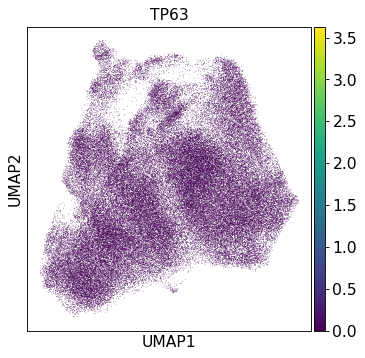

Ciliated


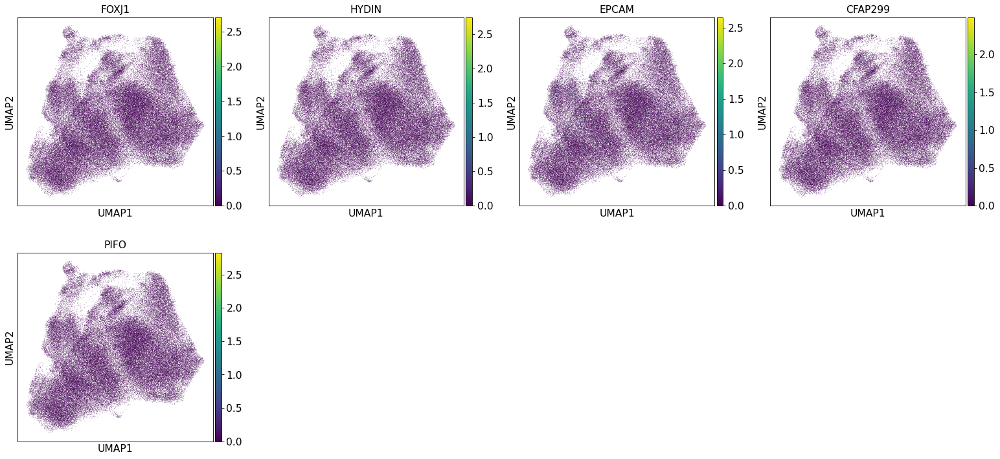

Club


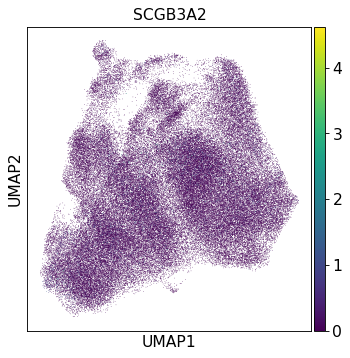

DC Lagerhans


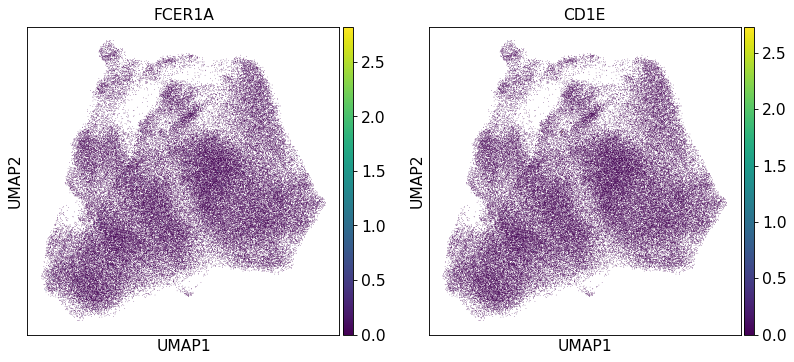

DC mature


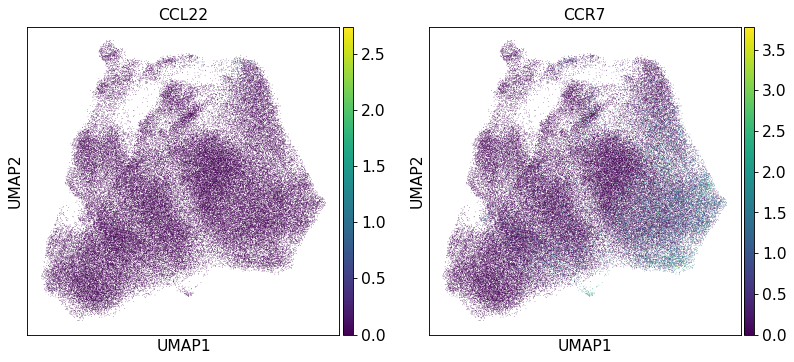

Dividing


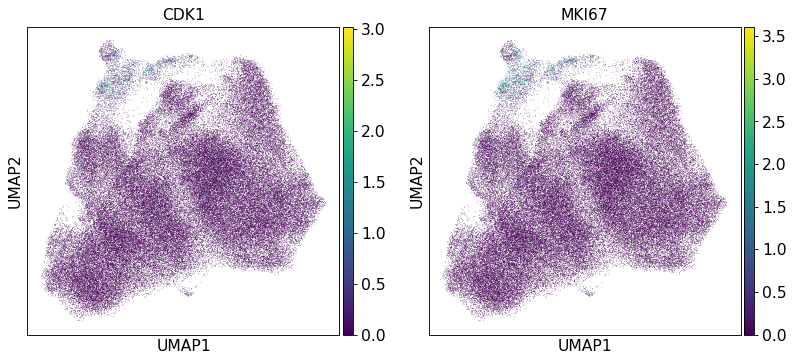

Endothelial cell


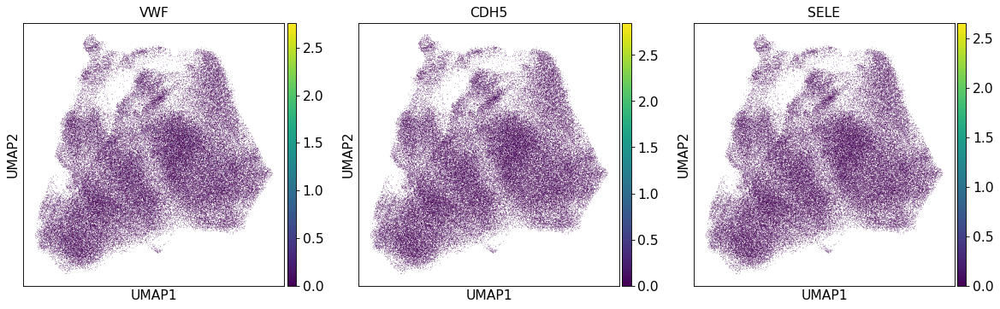

Endothelial cell lymphatic


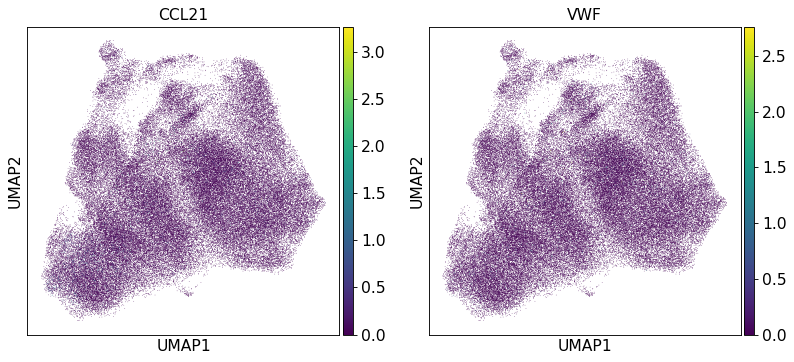

Epithelial


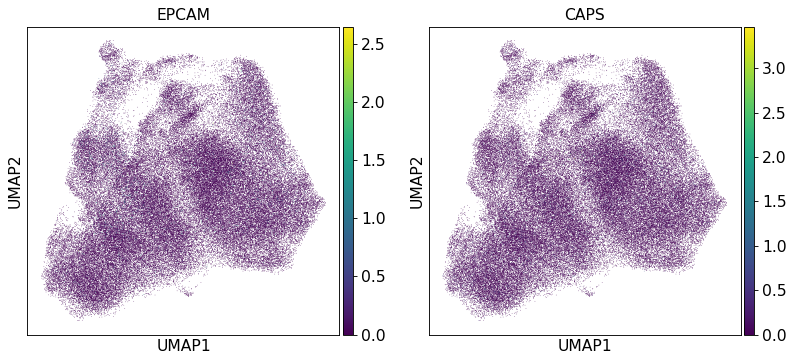

Fibroblast


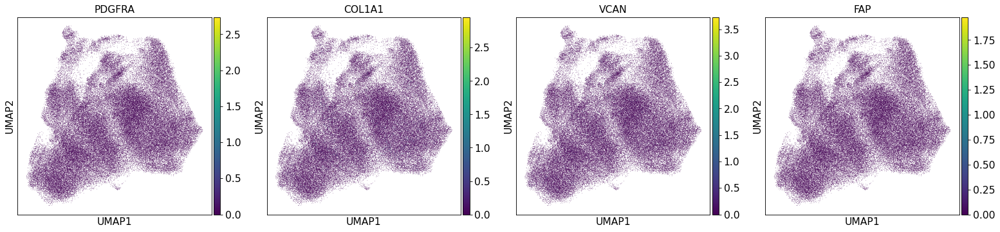

Fibroblast adventitial


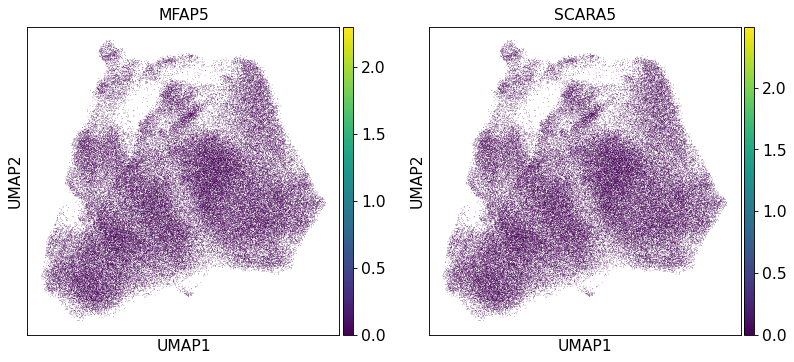

Fibroblast alveolar


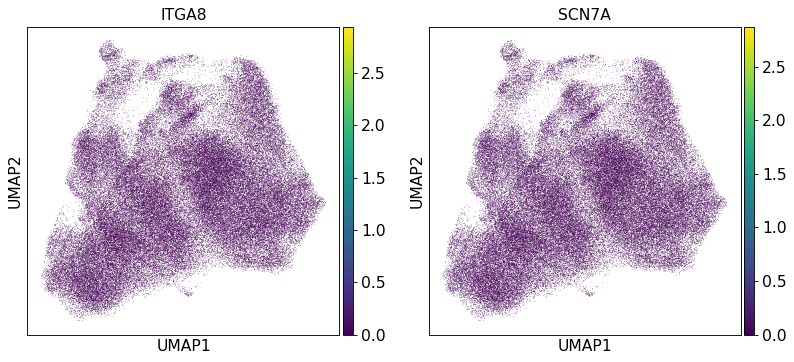

Goblet


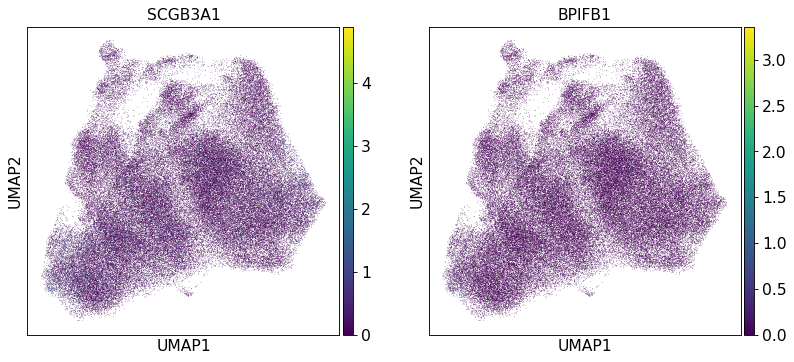

Ionocyte


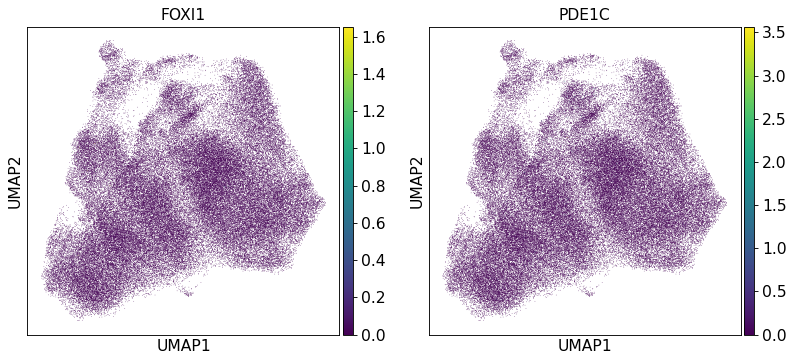

Macrophage


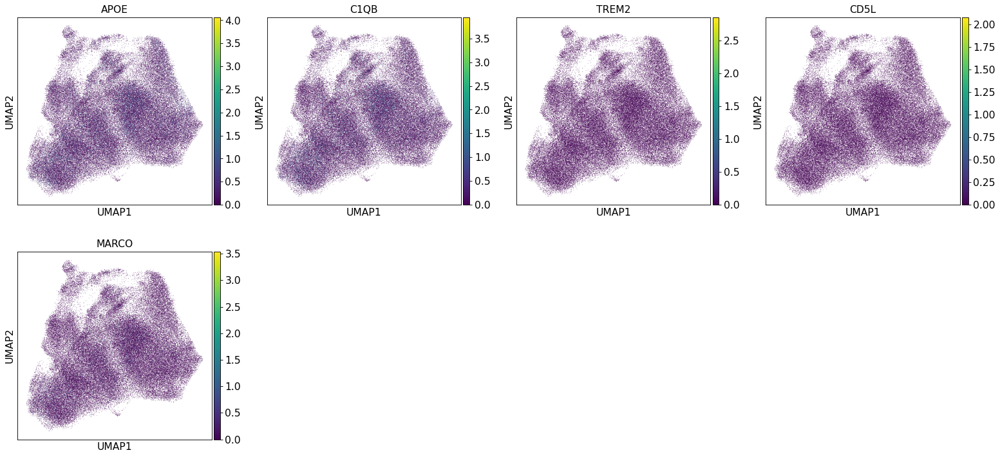

Macrophage alveolar


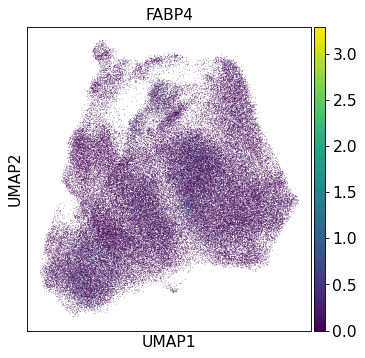

Mast cells


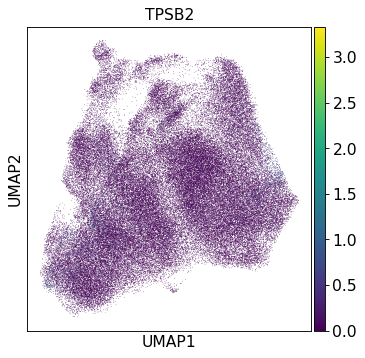

Mesothelial


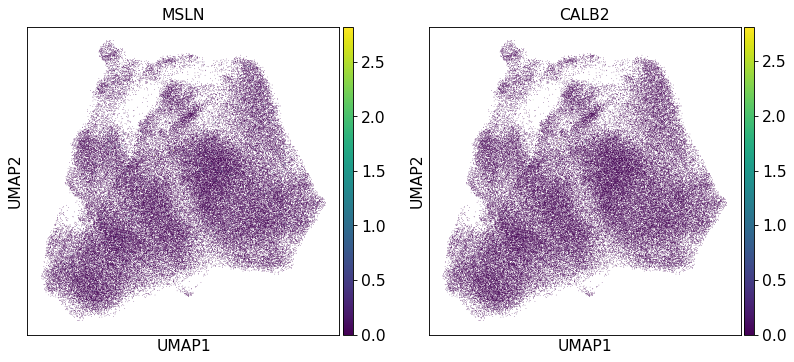

Monocyte


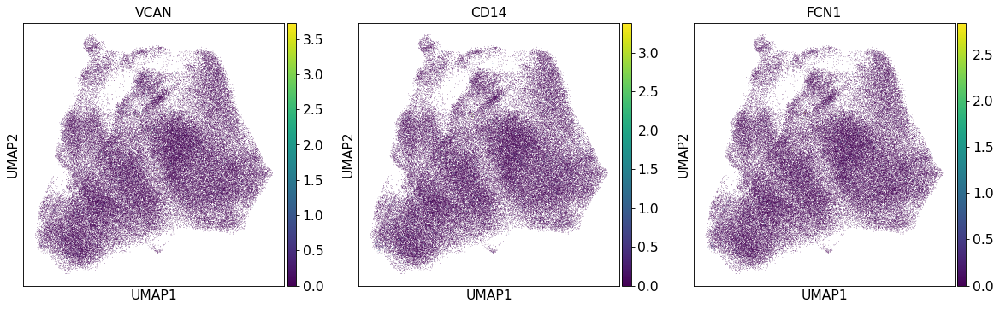

Monocyte conventional


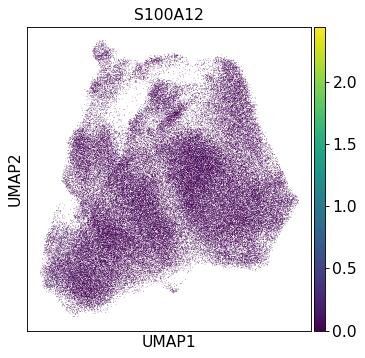

Monocyte non-coventional


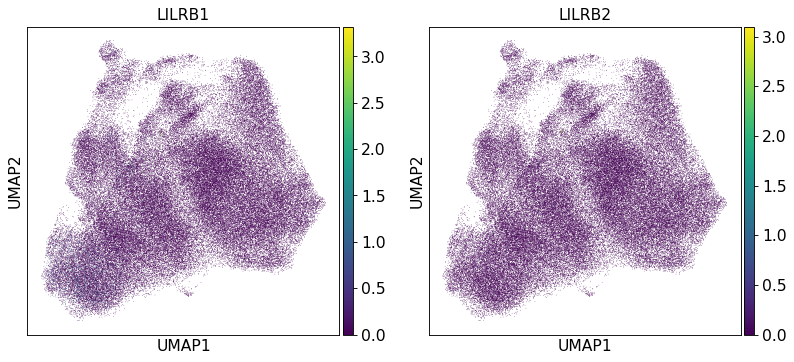

NK cell


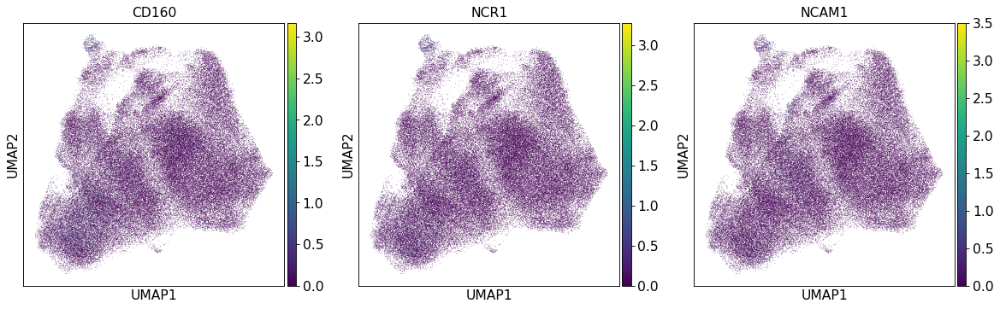

Pericyte


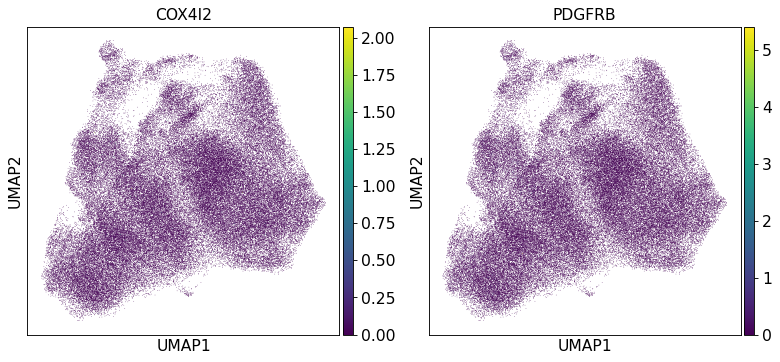

Plasma cell


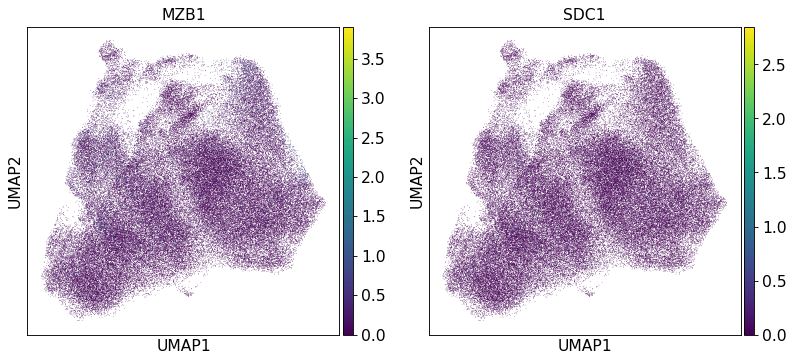

Pulmonary neuroendocrine cell


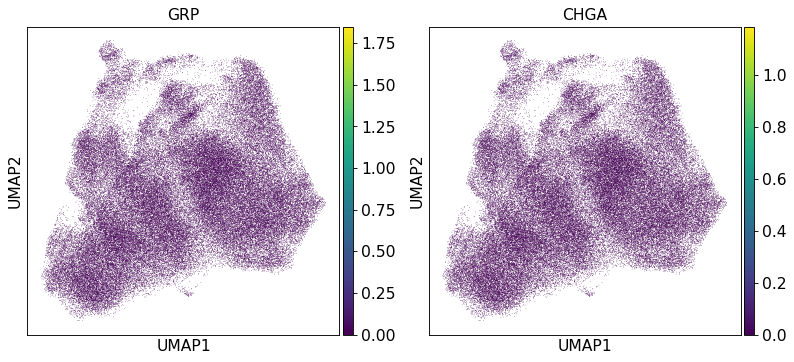

Smooth muscle cell


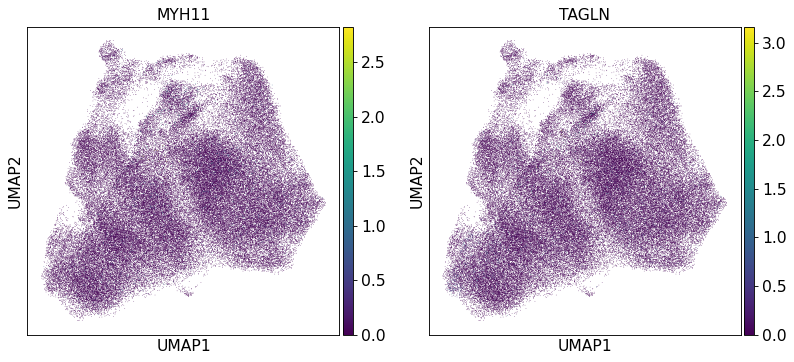

Suprabasal


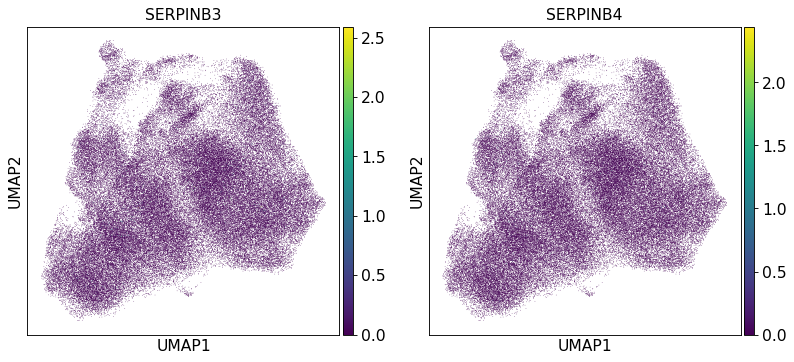

T cell


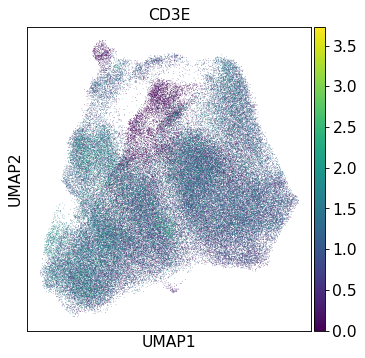

T cell CD4


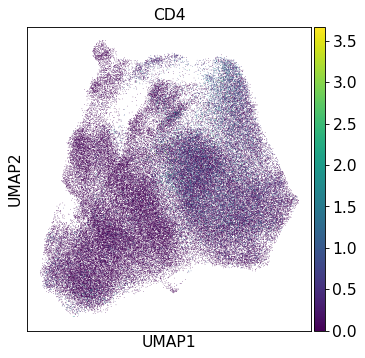

T cell CD8


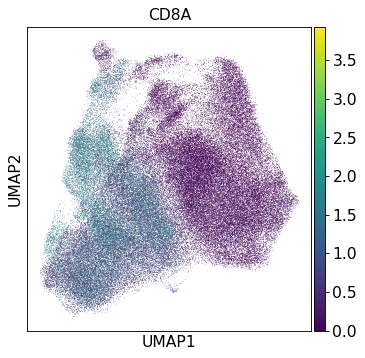

T cell cytotoxic


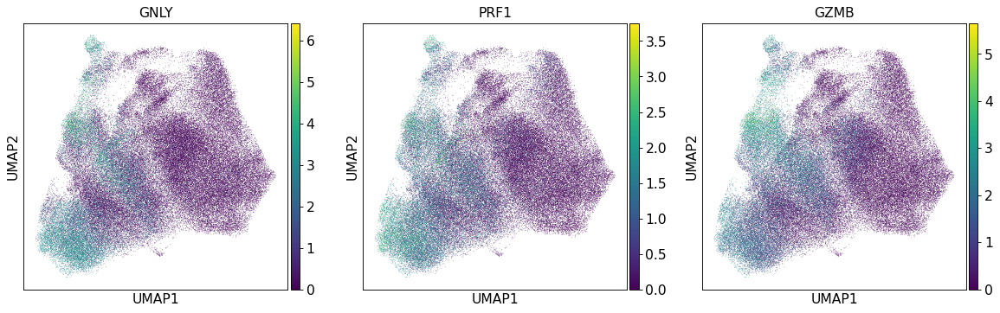

T cell regulatory


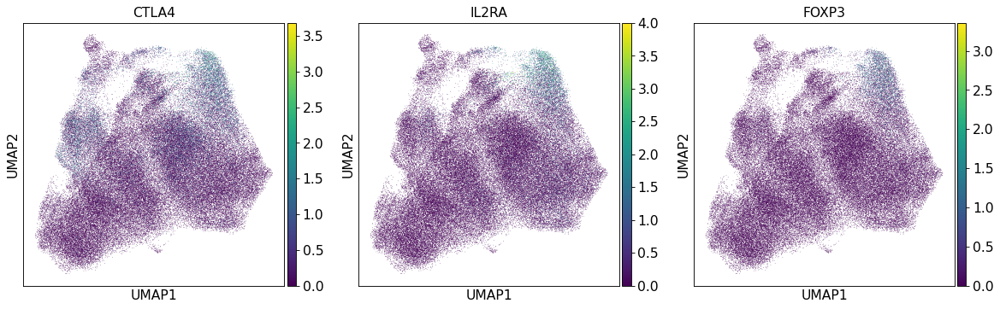

Vessel


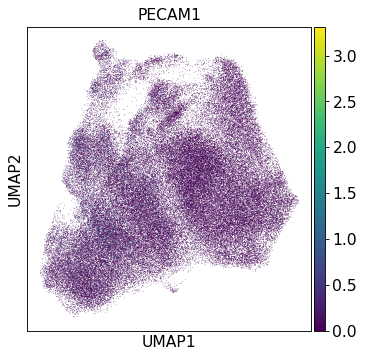

cDC1


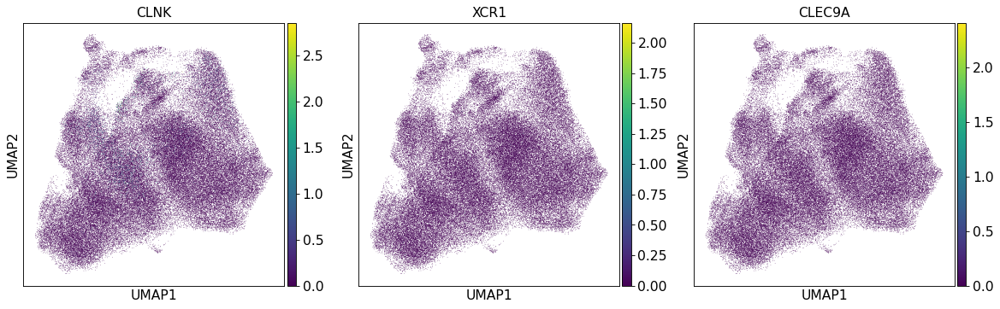

cDC2


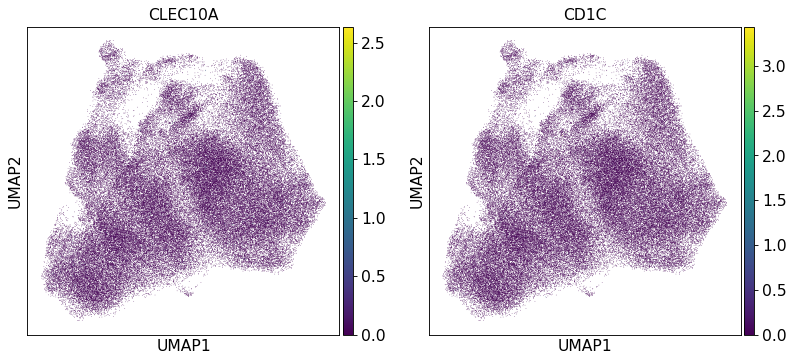

pDC


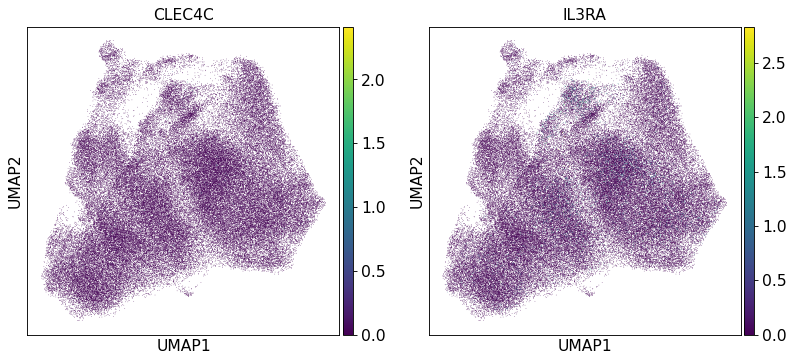

In [25]:
ah.plot_umap(adata_t)

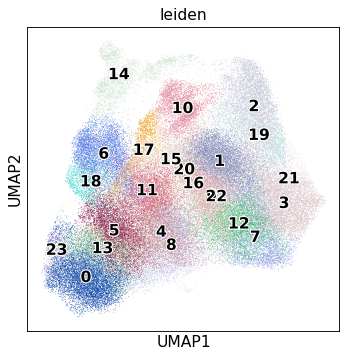

In [26]:
sc.pl.umap(adata_t, color="leiden", legend_loc="on data", legend_fontoutline=2)

In [27]:
ct_mat = {
    "T cell dividing": [14],
    "T cell CD8": [0, 13, 23, 5, 4, 8, 11, 18, 16, 6],
    "T reg": [2, 19],
    "T cell CD4": [7, 12, 22, 3, 16, 9, 1, 21],
    "other T assoc.": [17, 15, 10, 20],
}

... storing 'cell_type' as categorical


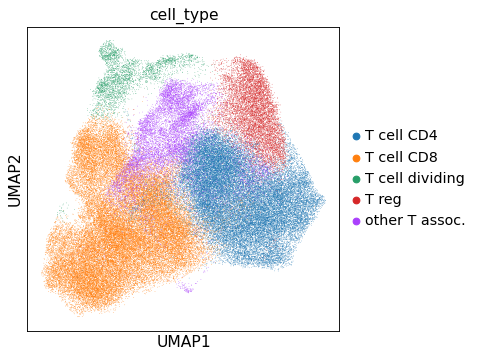

In [28]:
ah.annotate_cell_types(adata_t, ct_mat)

... storing 'cell_type' as categorical


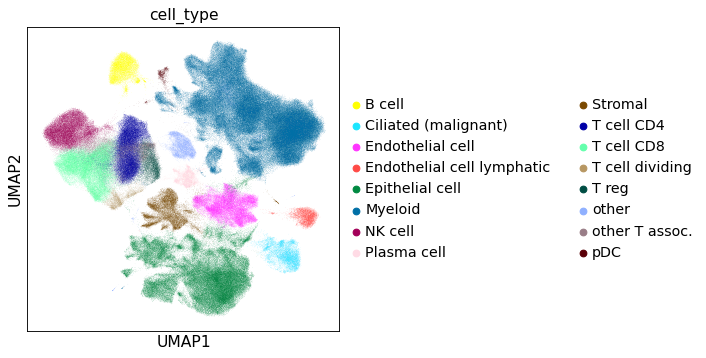

In [29]:
ah.integrate_back(adata, adata_t)

In [30]:
adata_m = adata[adata.obs["cell_type"] == "Myeloid", :].copy()
ah.reprocess_adata_subset_scvi(adata_m, use_rep="X_scANVI", n_neighbors=15)

/home/sturm/.conda/envs/pircher-sc-infercnv/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


DC Lagerhans


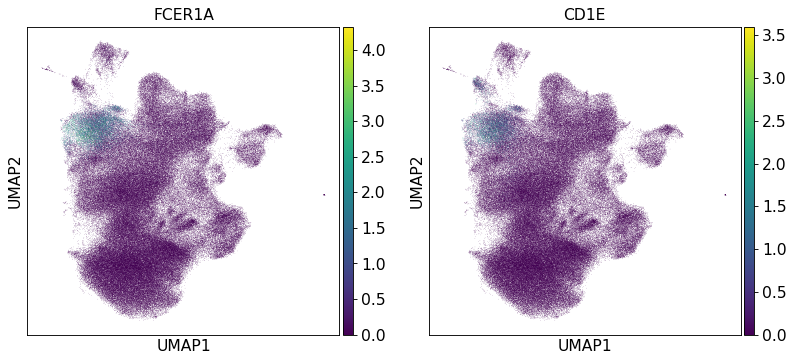

DC mature


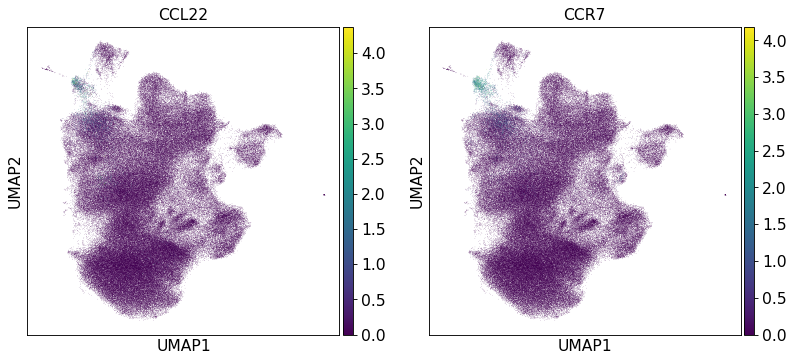

Dividing


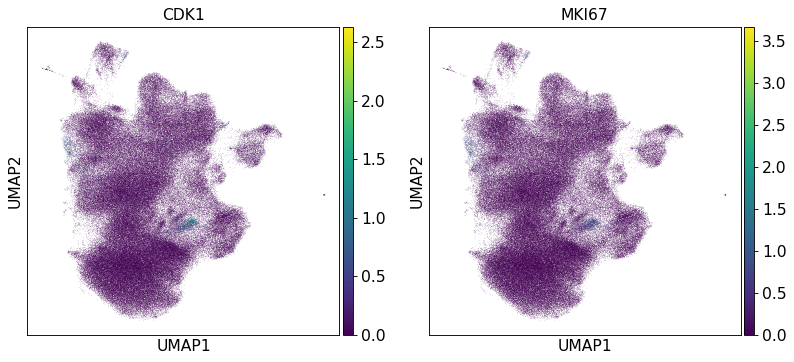

Macrophage


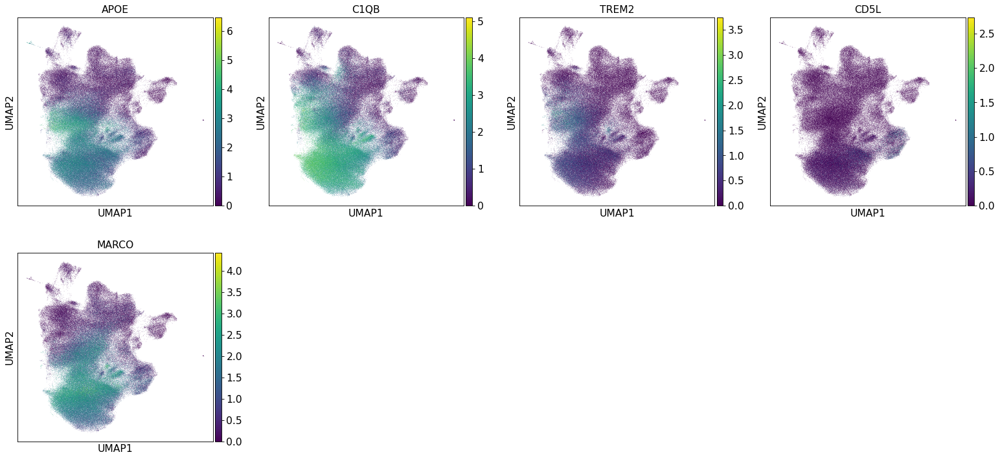

Macrophage alveolar


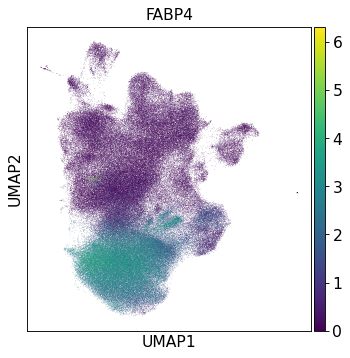

Monocyte


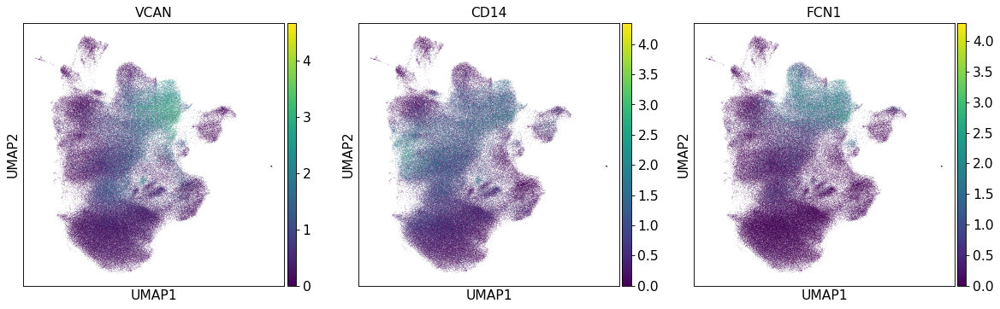

Monocyte conventional


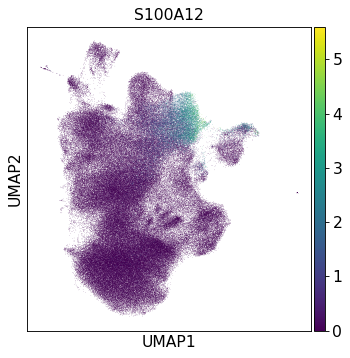

Monocyte non-coventional


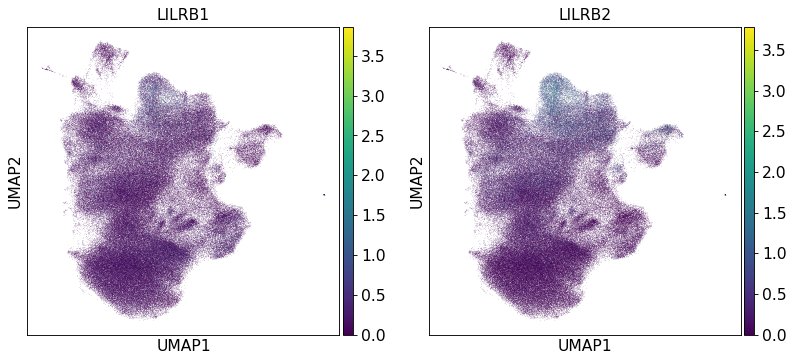

cDC1


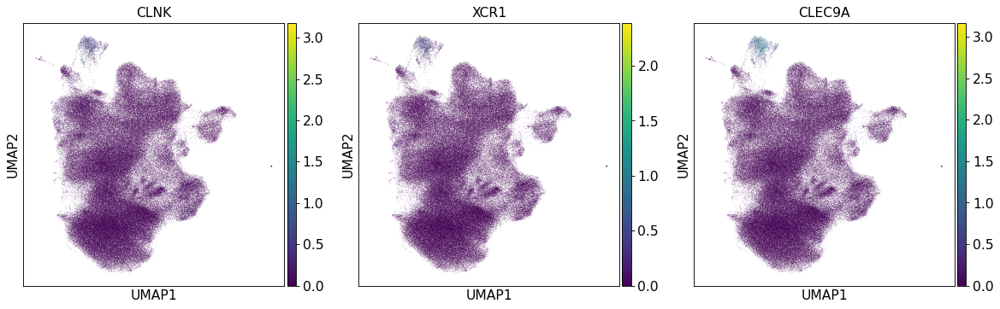

cDC2


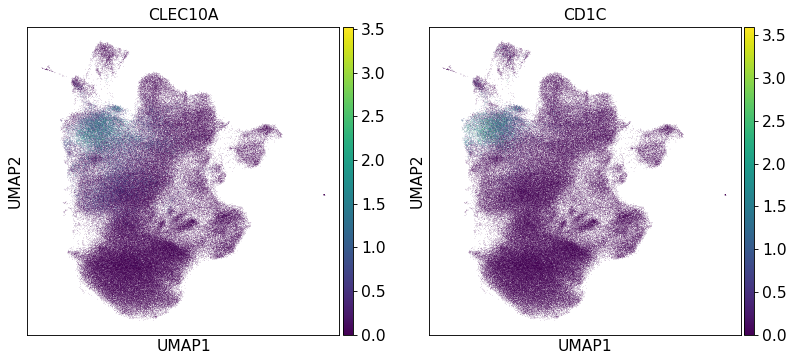

pDC


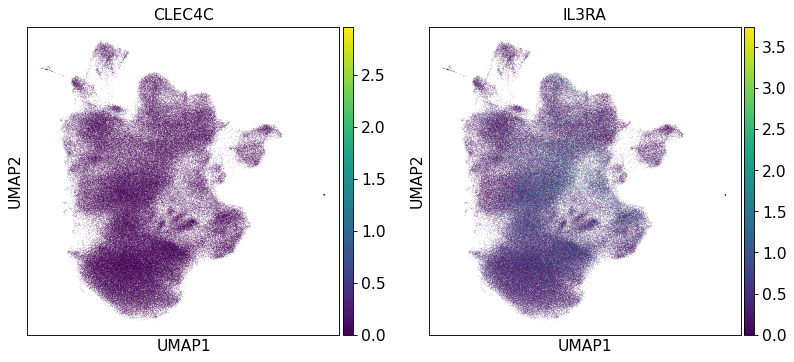

In [31]:
ah.plot_umap(adata_m, filter_cell_type=["Macro", "Mono", "DC", "Div"])

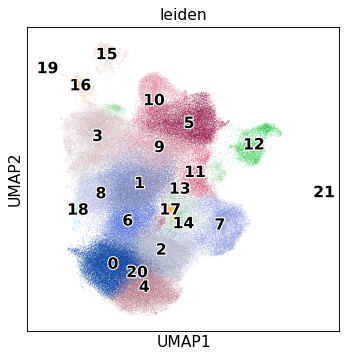

In [32]:
sc.pl.umap(adata_m, color="leiden", legend_loc="on data", legend_fontoutline=2)

In [33]:
ct_map = {
    "DC mature": [16],
    "Macrophage": [8, 1, 6, 17, 18],
    "Monocyte conventional": [5, 9],
    "Monocyte non-conventional": [10],
    "Macrophage alevolar": [0, 4, 20, 2, 6, 17, 14],
    "cDC1": [15],
    "cDC2": [3],
    "other myeloid assoc.": [12, 19, 21, 13],
    "myeloid other": [11, 7]
}

... storing 'cell_type' as categorical


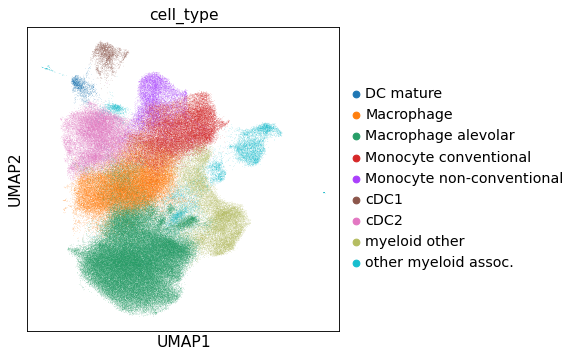

In [34]:
ah.annotate_cell_types(adata_m, ct_map)

... storing 'cell_type' as categorical


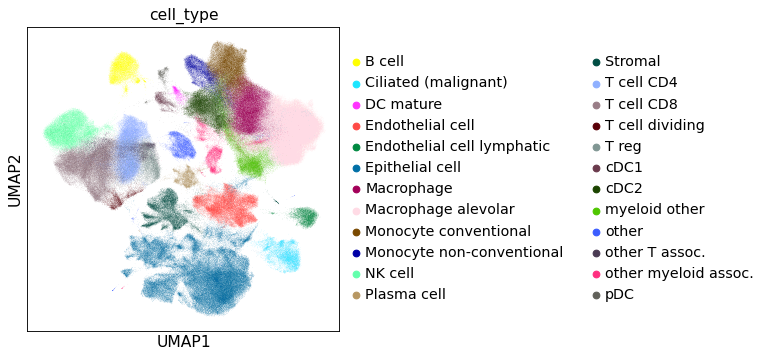

In [35]:
ah.integrate_back(adata, adata_m)

In [36]:
adata_s = adata[adata.obs["cell_type"] == "Stromal", :].copy()
ah.reprocess_adata_subset_scvi(
    adata_s, leiden_res=1, use_rep="X_scANVI", n_neighbors=15
)

/home/sturm/.conda/envs/pircher-sc-infercnv/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Dividing


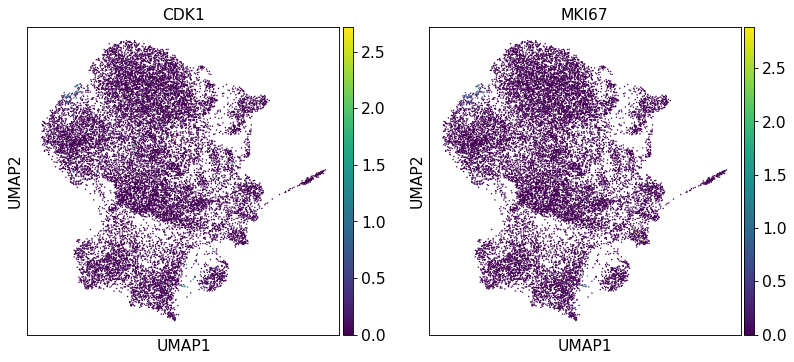

Endothelial cell


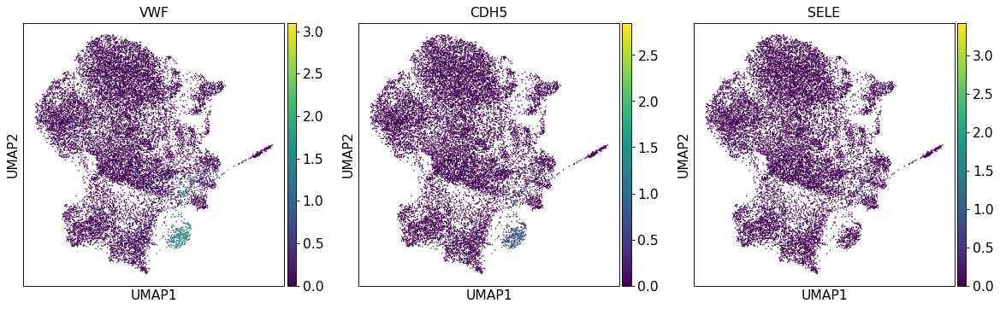

Endothelial cell lymphatic


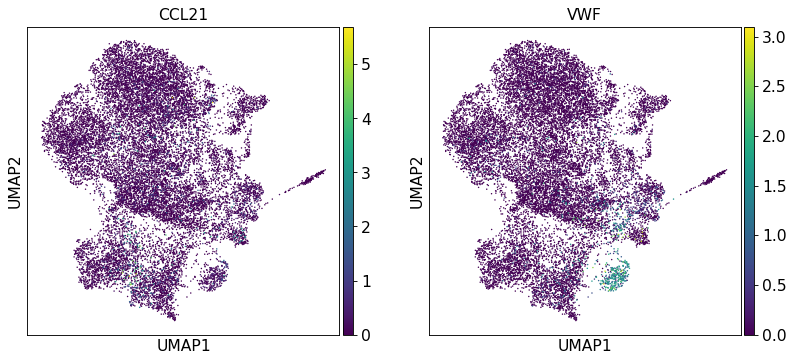

Fibroblast


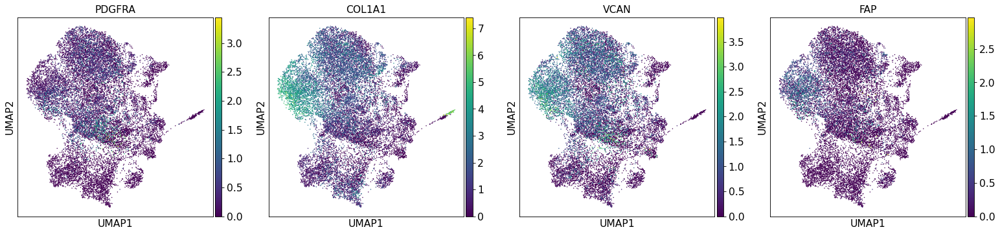

Fibroblast adventitial


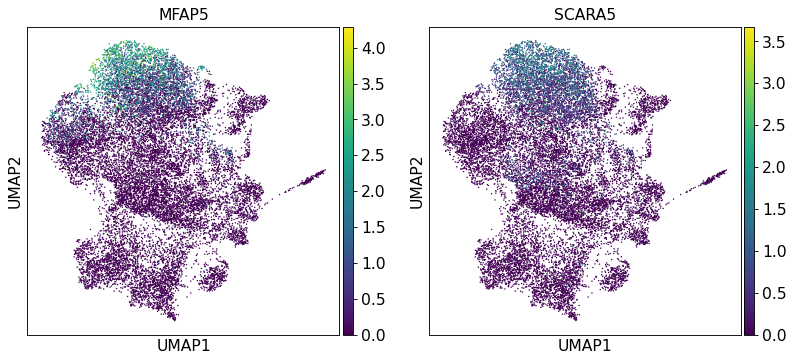

Fibroblast alveolar


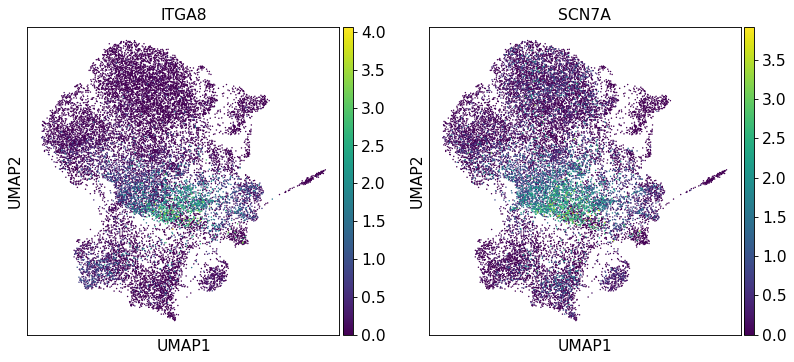

Mesothelial


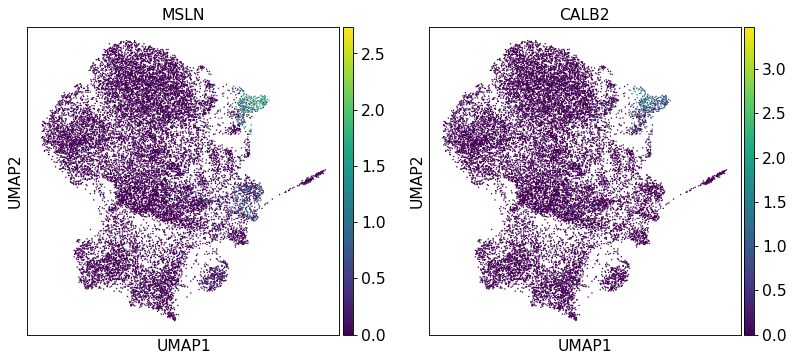

Pericyte


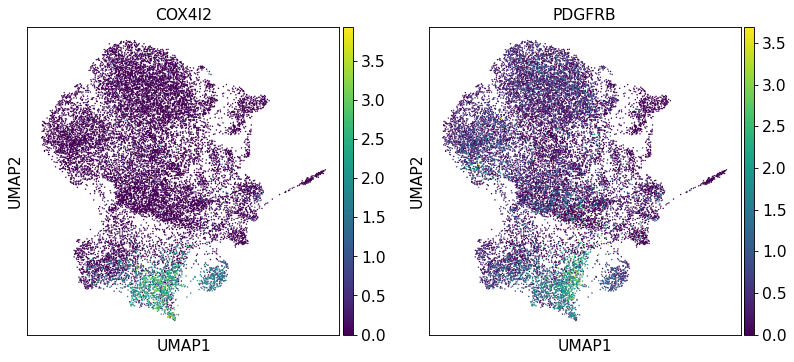

Smooth muscle cell


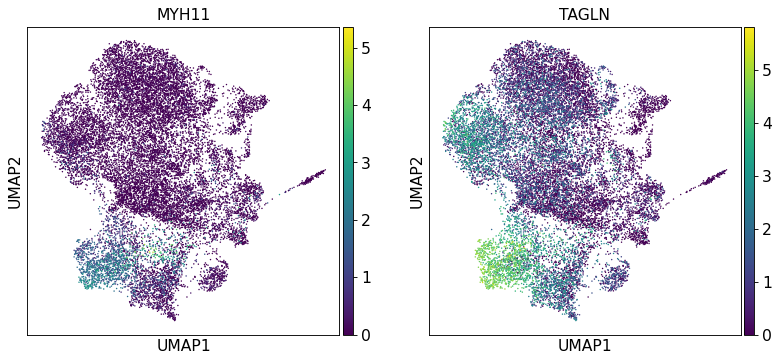

In [37]:
ah.plot_umap(adata_s, filter_cell_type=["Fibro", "muscle", "Peri", "Meso", "Endo", "Div"])

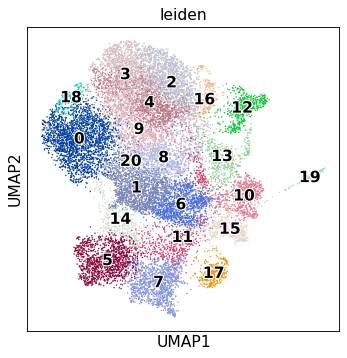

In [38]:
sc.pl.umap(adata_s, color="leiden", legend_loc="on data", legend_fontoutline=2)

In [39]:
ct_map = {
    "Fibroblast": [0, 18, 9, 8],
    "Fibroblast adventitial": [3, 2, 4],
    "Fibroblast alevolar": [6, 1],
    "Smooth muscle cell": [5, 14],
    "Mesothelial": [12],
    "Pericyte": [7, 11, 17],
    "stromal other": [15, 10, 19, 13, 16]
}

... storing 'cell_type' as categorical


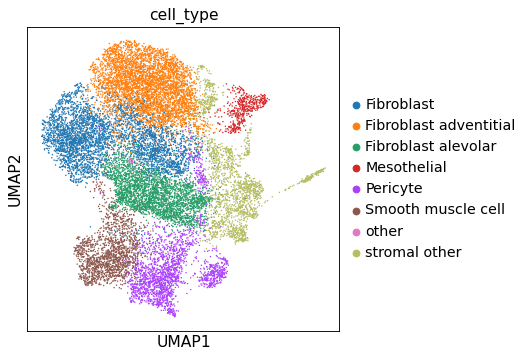

In [40]:
ah.annotate_cell_types(adata_s, ct_map)

... storing 'cell_type' as categorical


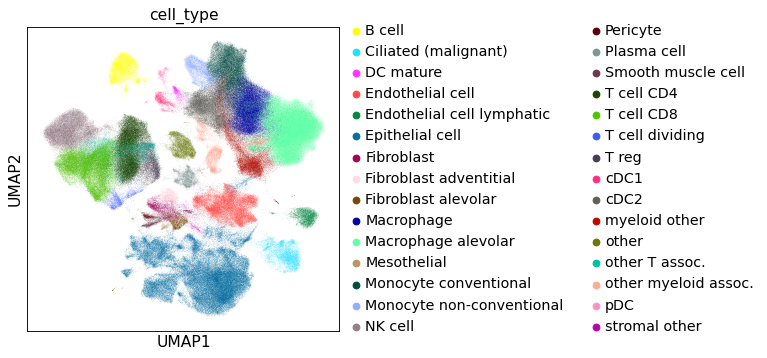

In [41]:
ah.integrate_back(adata, adata_s)

In [42]:
adata_epi = adata[adata.obs["cell_type"] == "Epithelial cell", :].copy()

/home/sturm/.conda/envs/pircher-sc-infercnv/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [43]:
ah.reprocess_adata_subset_scvi(adata_epi, use_rep="X_scANVI")

In [44]:
ah.reprocess_adata_subset_cnv(adata_epi)

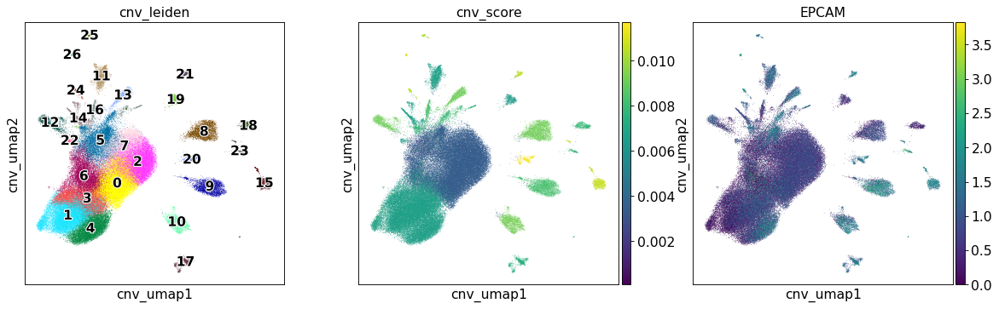

In [45]:
cnv.pl.umap(
    adata_epi,
    color=["cnv_leiden", "cnv_score", "EPCAM"],
    legend_loc="on data",
    legend_fontoutline=2,
)

In [46]:
cnv.tl.infercnv(adata_epi, reference_key="cnv_leiden", reference_cat=["4", "2", "10"])

/home/sturm/.conda/envs/pircher-sc-infercnv/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
100%|██████████| 21/21 [00:21<00:00,  1.00s/it]


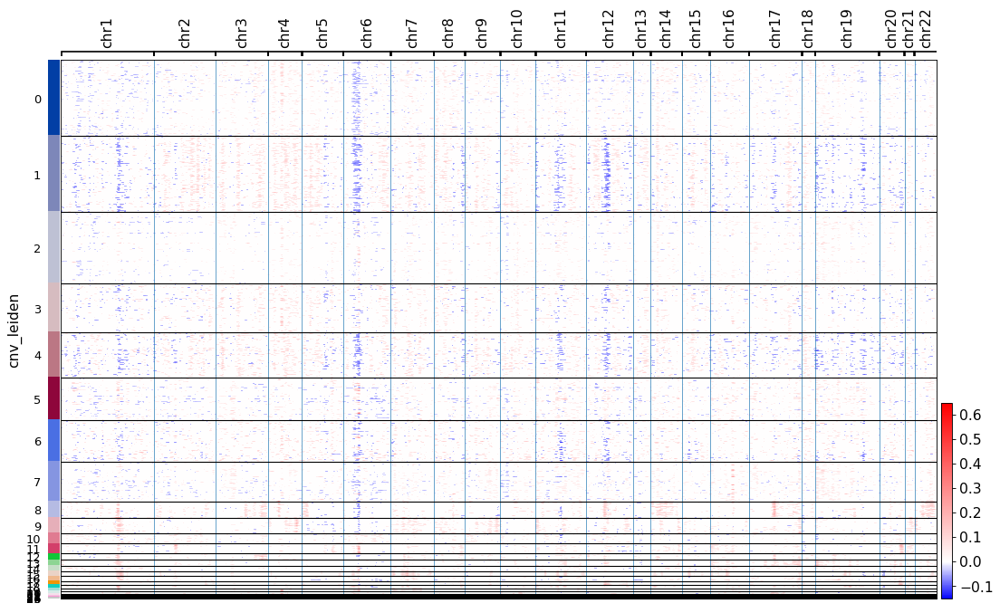

In [47]:
cnv.pl.chromosome_heatmap(adata_epi)

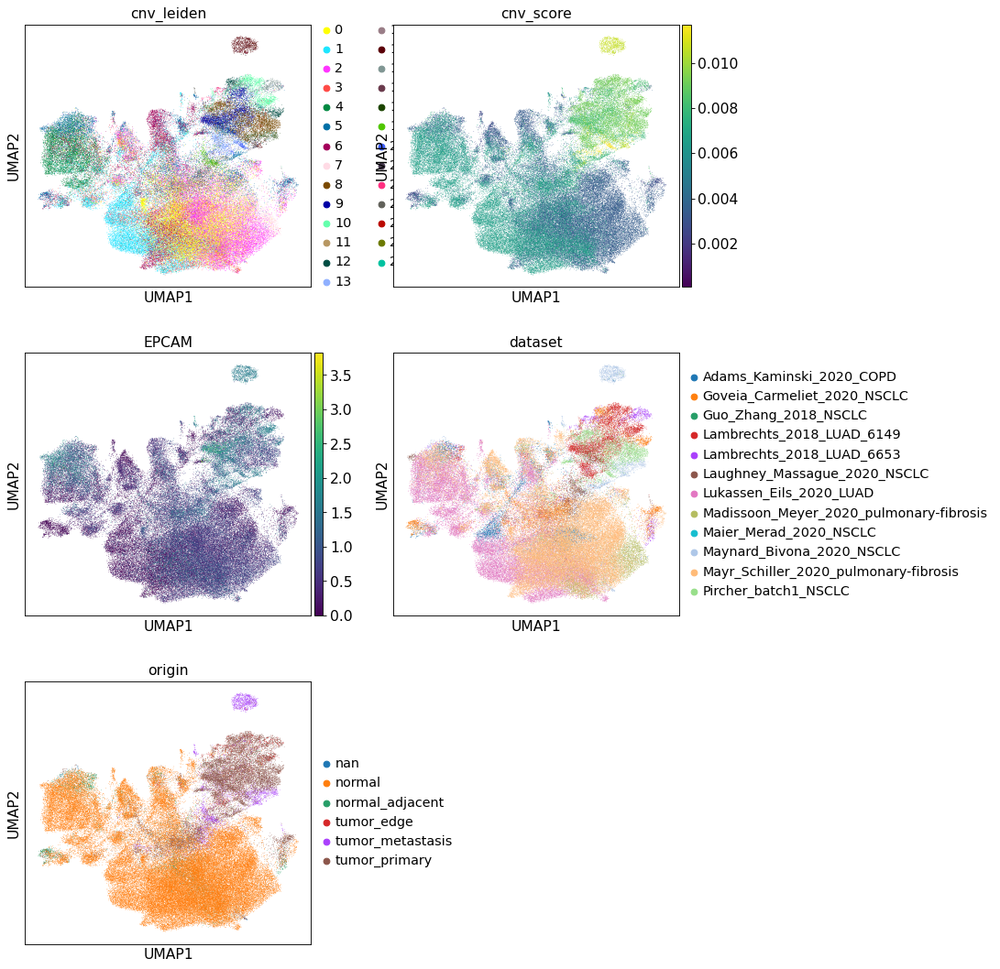

In [48]:
sc.pl.umap(adata_epi, color=["cnv_leiden", "cnv_score", "EPCAM", "dataset", "origin"], ncols=2)

Alevolar cell type 1


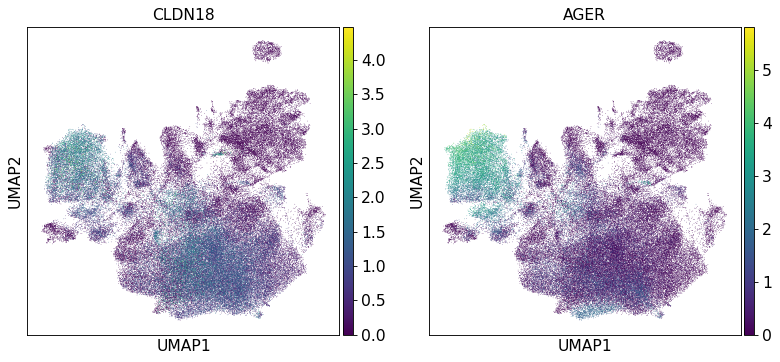

Alevolar cell type 2


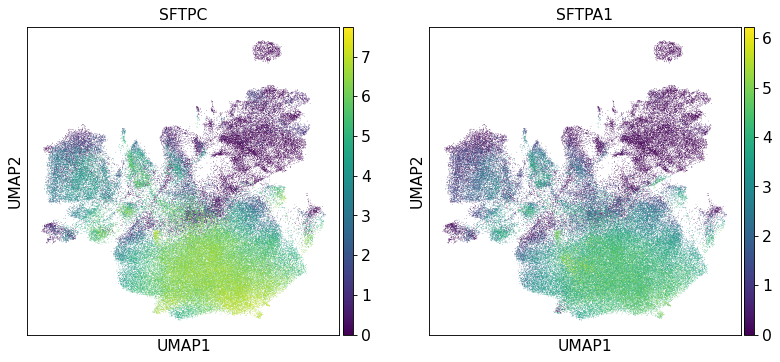

Alevolar cells (type 1 and 2)


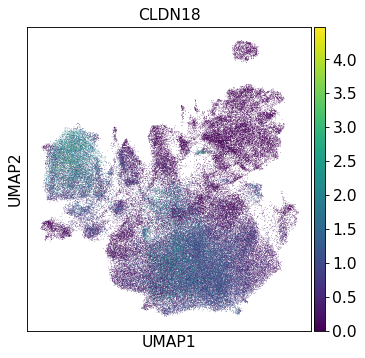

Basal


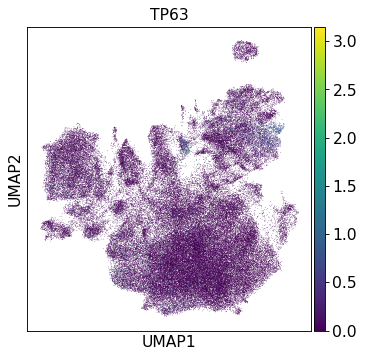

Club


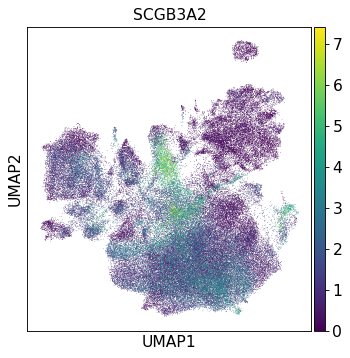

Dividing


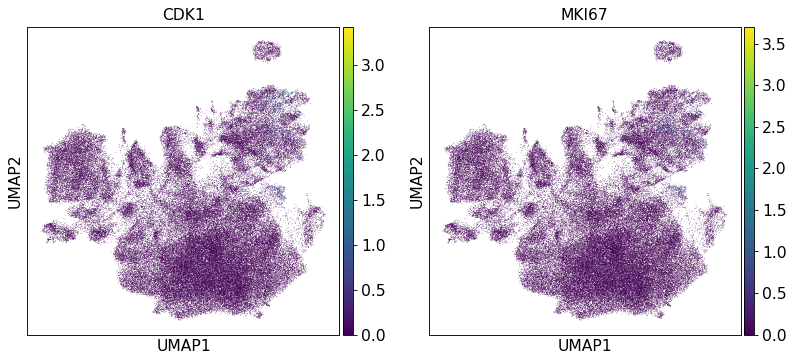

Epithelial


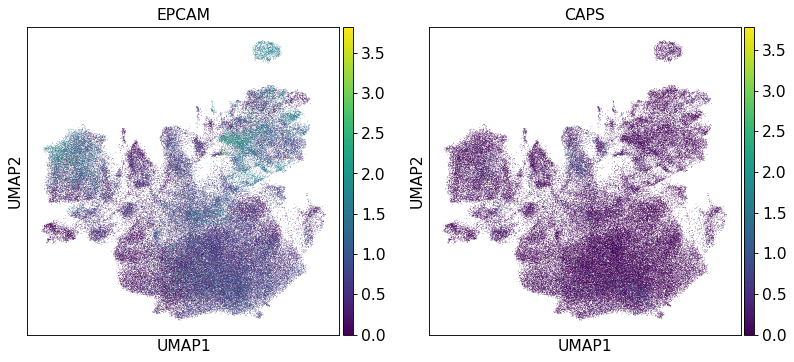

Goblet


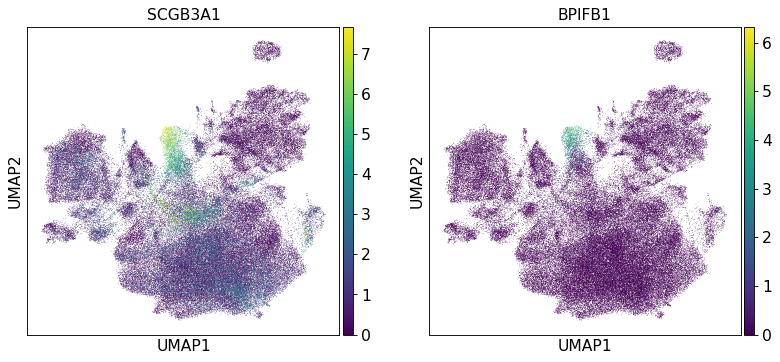

Ionocyte


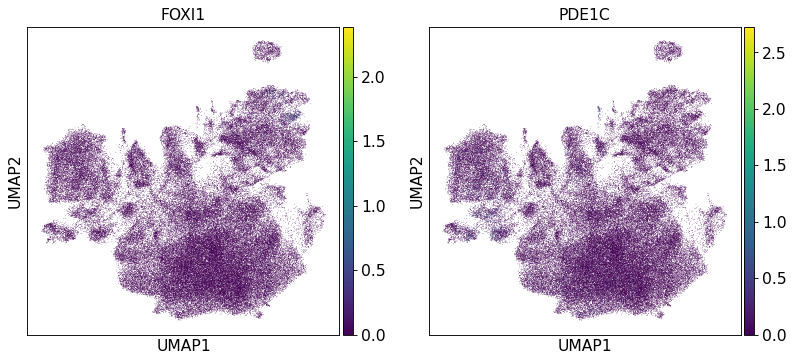

Mesothelial


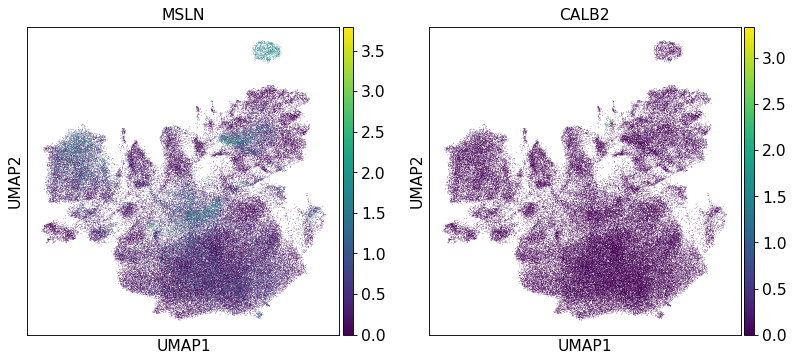

Suprabasal


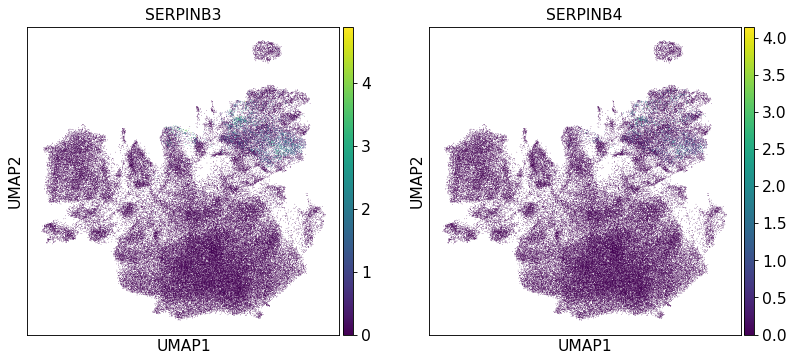

In [49]:
ah.plot_umap(
    adata_epi,
    filter_cell_type=[
        "Alevolar",
        "Basal",
        "Club",
        "Dividing",
        "Goblet",
        "Ionocyte",
        "Mesothelial",
        "Suprabasal",
        "Epi",
    ],
)

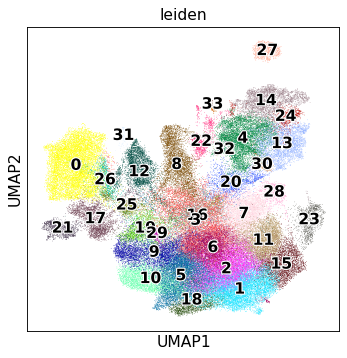

In [50]:
sc.pl.umap(adata_epi, color="leiden", legend_loc="on data", legend_fontoutline=2)

In [51]:
ct_map = {
    "Epithelial cell (malignant)": [27, 14, 24, 33, 4, 13, 30, 20, 32],
    "Alevolar cell type 1": [0, 26],
    "Alevolar cell type 2": [9, 10, 5, 6, 2, 7, 11, 15, 1, 18],
    "Club/Goblet": [8, 3, 16],
    "Epithelial cell dividing": [28],
    "Epithelial cell other (benign)": [21, 22, 23, 12, 17, 25, 19, 29, 31],
}

... storing 'cell_type' as categorical


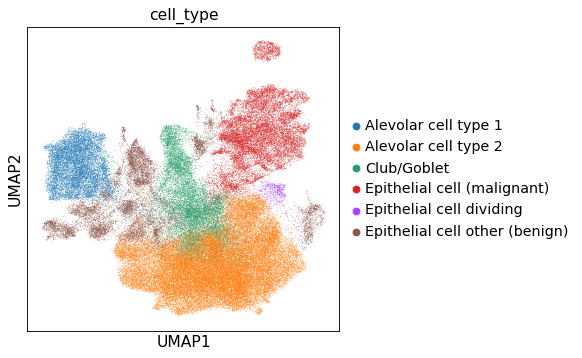

In [52]:
ah.annotate_cell_types(adata_epi, ct_map)

... storing 'cell_type' as categorical


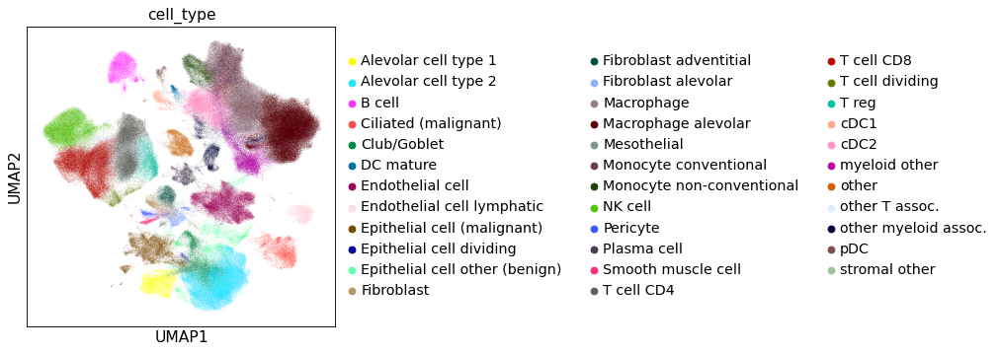

In [53]:
ah.integrate_back(adata, adata_epi)

In [54]:
adata.obs["is_malignant"] = [
    "malignant" if x else "non-malignant"
    for x in adata.obs["cell_type"].str.contains("mali")
]

... storing 'is_malignant' as categorical


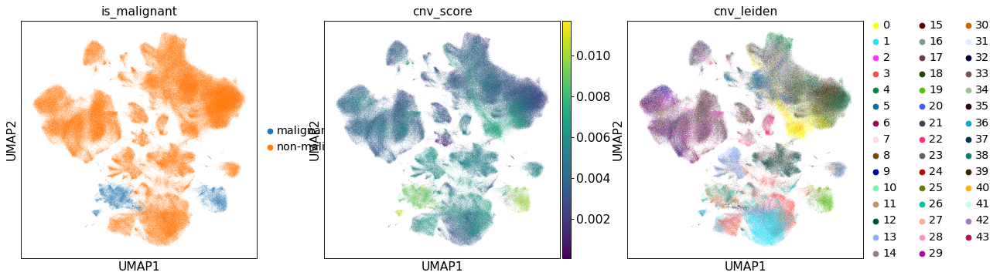

In [55]:
sc.pl.umap(adata, color=["is_malignant", "cnv_score", "cnv_leiden"])

In [56]:
adata.write_h5ad("../../data/60_infercnv/all-annotated-integrated.h5ad")

In [57]:
!mkdir -p ../../tables/single_cell_annotations/all_integrated

In [58]:
adata_scvi = sc.AnnData(
    X=adata.obsm["X_scANVI"], obs=adata.obs.loc[:, ["cell_type", "cnv_leiden"]]
)
adata_scvi.write_h5ad(
    "../../tables/single_cell_annotations/all_integrated/adata_scvi.h5ad",
    compression="gzip",
    compression_opts=9,
)

In [59]:
adata.obs.loc[:, ["cell_type", "cnv_leiden"]].to_csv(
    "../../tables/single_cell_annotations/all_integrated/cell_type_annotations.csv"
)